In [ ]:
!pip install --upgrade --no-cache-dir gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Attempting uninstall: gdown
    Found existing installation: gdown 4.4.0
    Uninstalling gdown-4.4.0:
      Successfully uninstalled gdown-4.4.0


In [ ]:
import torch, torchvision, os, PIL, pdb
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def show(tensor, num=25, wandbactive=0, name=''):

  # mengambil data tensor yang didetach terlebih dahulu dari gpu dan ditransfer ke cpu agar dapat ditampilkan oleh fungsi plt.imshow
  
  data = tensor.detach().cpu()

  # membuat grid dari data yang sudah diambil dari tensor, dengan baris 5.
  # lalu dipermute(1, 2, 0) karena data dari tensor sebelumnya memiliki dimensi(batch_size, channel, height, width).
  # setelah dipermute menjadi (heigh, width, channel). hasil dari permute membuat data dapat ditampilkan dengan benar menggunakan plt.imshow
  
  grid = make_grid(data[:num], nrow=5).permute(1,2,0)
  
  # optional
  # apabila wandbact=1 mengirim grid ke wandb sesuai dengan parameter input name
  
  if(wandbactive==1):
    wandb.log({name:wandb.Image(grid.numpy().clip(0,1))})
  plt.imshow(grid.clip(0,1))
  plt.show()

# hyperparameter & general parameter
# jumlah epoch

n_epochs = 10000

# jumlah sample yang digunakan dalam satu iterasi learning

batch_size = 128

# learning rate = 0.0001

lr = 1e-4

# dimensi ruang laten yang dipakai dalam generator (jumlah fitur yang digunakan untuk mengambil sampel acak dari ruang laten)
z_dim = 200

device = 'cuda'
cur_step = 0
crit_cycles = 5
gen_losses = []
crit_losses = []
show_step = 35
save_step = 35
wandbact = 1

In [ ]:
# optional
!pip install wandb -qqq
import wandb
wandb.login(key='444a4cc88c98ea16d3933f474a957b7a3e10390f')

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 31.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.3/181.3 KB 23.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 22.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 KB 5.4 MB/s eta 0:00:00


wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
%%capture
experiment_name = "wgan"
myrun = wandb.init(
    project = "wgan",
    group = experiment_name,
    config = {
        "optimizer":"adam",
        "model":"wgan gp",
        "epoch":"1000",
        "batch_size":128
    }
)
config = wandb.config

In [ ]:
print(experiment_name)

wgan


In [ ]:
from torch.nn.modules.activation import Tanh
from torch.nn.modules.conv import Conv2d

# generator model
# mendefinisikan kelas generator yang mewarisi kelas nn.Module dari pytorch, digunakannya nn.Module dikarenakan mempunyai fungsi pembantu
# yaitu forward propagation dan backward propagation, serta parameter2 untuk menyimpan nilai layer dalam model 

class Generator(nn.Module):

  # mendefinisikan fungsi init sebagai konstruktor kelas generator dengan parameter z_dim dan d_dim
  # z_dim : jumlah ruang laten yang digunakan sebagai input generator
  # d_dim : d_dim adalah jumlah channel yang digunakan dalam setiap lapisan (layer)
  
  def __init__(self, z_dim=64, d_dim=16):
    super(Generator, self).__init__()
    self.z_dim = z_dim

    # diinisasi gen dengan nilai perhitungan melalui nn.Sequential
    # nn.Sequential adalah modul yang berfungsi untuk mengelompokan modul modul menjadi rangkaian modul yang lebih besar.
    # dimana modul yang dirangkai akan dieksekusi secara berurutan.
    # dengan setiap modul akan menerima input dari modul sebelumnya dan menghasilkan -
    # output yang akan digunakan sebagai input untuk modul berikutnya

    self.gen = nn.Sequential(
        
        # ConvTranspose2d : in_channels, out_channels, kernel_size, stride=1, padding=0
        # calculating new width & height : (n - 1) * stride - 2 * padding + ks
        # n : height & width, ks : kernel size
        # begin with 1x1 image with z_dim number of channels (200)

        # Conv2Transpose2d merupakan operasi yang digunakan untuk konvolusi transpose atau de-convolution pada tensor.
        # modul ini memiliki beberapa parameter yaitu :
        # in_channels : jumlah input channel
        # out_channels : jumlah output channel
        # kernel_size : ukuran kernel filter yang digunakan
        # stride : jarak antar titik saat dilakukan convolution
        # padding : jumlah padding yang ditambahkan pada setiap sisi tensor sebelum dilakukan convolution

        # proses layer pertama nn.ConvTranspose2d dimulai dengan in_channels sebesar self.z_dim (ruang laten = 200 dimensi),
        # out_channels sebesar d_dim * 32 (16x32=512), kernel_size sebesar 4, stride sebesar 1, dan padding sebesar 0,
        # dari parameter tersebut menghasilkan 512 channel yang akan digunakan pada operasi layer berikutnya
        # setelah melakukan perhitungan dilakukan proses nn.BatchNorm2d pada output channel yang akan dipakai pada layer berikutnya
        # nn.BatchNorm2d adalah lapisan perhitungan untuk normalisasi data pada setiap batch,
        # dengan menghitung mean dan standard deviation dari setiap channel pada data input,
        # lalu data input dikalikan dengan standard deviation dan dikurangi dengan mean.
        # dilakukannya normalisasi untuk mengontrol ukuran data input agar tidak terlalu besar atau terlalu kecil, training stabil dan cepat converge
        # selanjutnya dilakukan proses aktivasi dengan nn.ReLU(true), yaitu untuk menambah non-linearitas pada model
        # nilai yang lebih kecil dari 0 akan diubah menjadi 0 dengan input dari output nn.ConvTranspose2 sebelumnya,
        # dan True berarti dilakukan secara inplace pada tensor tanpa membuat copy
        # selanjutnya akan diulang proses pada tiap layer dengan parameter yang berbeda hingga menghasilkan output dengan ukutan 128x128 3 channel (RGB)
        
        nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0), # 4x4 (ch: 200, 512)
        nn.BatchNorm2d(d_dim * 32),
        nn.ReLU(True),

        # dilakukan proses transpose konvolusi ulang dengan in_channel merupakan output dari out_channel sebelumnya.
        # out_channel dideklarasikan dengan d_dim * 16 agar mendapatkan output 256 channel
        # parameter kernel_size, stride dan padding di isi dengan 4, 2, 1 yang bertujuan untuk mengubah ukuran height dan width menjadi 8x8
        # selanjutnya dilakukan normalisasi dan aktivasi seperti proses pada layer sebelumnya.

        nn.ConvTranspose2d(d_dim * 32, d_dim * 16, 4, 2, 1), # 8x8 (ch: 512, 256)
        nn.BatchNorm2d(d_dim * 16),
        nn.ReLU(True),

        # proses pada layer selanjutnya hampir sama dengan sebelumnya dengan mengubah parameter in dan out_channel agar menampilkan out 128
        # dan pada parameter kernel_size, stride dan padding sama dengan sebelumny karena dapat menghasilkan height width baru yaitu 16x16
        
        nn.ConvTranspose2d(d_dim * 16, d_dim * 8, 4, 2, 1), # 16x16 (ch: 256, 128)
        nn.BatchNorm2d(d_dim * 8),
        nn.ReLU(True),

        # proses pada layer selanjutnya hampir sama dengan sebelumnya dengan mengubah parameter in dan out_channel agar menampilkan out 64
        # dan pada parameter kernel_size, stride dan padding sama dengan sebelumny karena dapat menghasilkan height width baru yaitu 32x32

        nn.ConvTranspose2d(d_dim * 8, d_dim * 4, 4, 2, 1), # 32x32 (ch: 128, 64)
        nn.BatchNorm2d(d_dim * 4),
        nn.ReLU(True),

        # proses pada layer selanjutnya hampir sama dengan sebelumnya dengan mengubah parameter in dan out_channel agar menampilkan out 32
        # dan pada parameter kernel_size, stride dan padding sama dengan sebelumny karena dapat menghasilkan height width baru yaitu 64x64

        nn.ConvTranspose2d(d_dim * 4, d_dim * 2, 4, 2, 1), # 64x64 (ch: 64, 32)
        nn.BatchNorm2d(d_dim * 2),
        nn.ReLU(True),

        # proses pada layer terakhir sedikit berbeda dengan sebelumnya dimana pada in_channel masih menggunakan out_channel layer sebelumnya
        # sedangkan pada out_channel menggunakan nilai 3, hal ini bertujuan agar output channel sesuai dengan yang diinginkan yaitu RGB=3 chanel
        # dan pada parameter kernel_size, stride dan padding sama dengan sebelumny karena dapat menghasilkan height width baru yaitu 128x128
        # selanjutnya tidak dilakukan normalisasi maupun aktivasi melainkan fungsi nn.Tanh()
        # nn.Tanh() adalah fungsi aktivasi akhir dari layer pada generator. fungsi ini digunakan untuk membatasi nilai output dari generator pada rentang -1 sampai 1
        # agar output dari generator dapat diterima oleh fungsi loss yang digunakan dalam learning.
        # nn.Tanh() cocok digunakan karena menghasilkan output yang berdisitribusi normal
        
        nn.ConvTranspose2d(d_dim * 2, 3, 4, 2, 1), # 128x128 (ch: 32, 3)
        nn.Tanh() # produce result in the range of -1 & 1
    )

  # dideklarasikan fungsi forward yang merupakan fungsi forward propagation turunan dari nn.Module kelas generator
  # fungsi forward memiliki parameter noise, nantinya noise yang diinput akan diolah melalui proses Sequential sebelumnya
  # dilakukan pengubahan bentuk tensor noise dari awalnya (batch_size, z_dim) menjadi (batch_size, z_dim, 1, 1)
  # hal ini untuk menambahkan dimensi 1x1 untuk nantinya digunakan sebagi input pada proses konvolusi transpose nn.ConvTranspose2d di kelas generator
  # selanjutnya di return untuk menjalakan forward propagation pada generator dengan input x sebelumnya. 

  def forward(self, noise):
    x = noise.view(len(noise), self.z_dim, 1, 1) # structure : 128 x 200 x 1 x 1
    return self.gen(x)

# dideklarasikan fungsi gen_noise yg digunakan untuk menghasilkan data acak yg nantinya digunakan sebagai input fungsi forward
# data acak ini disebut sebagai ruang laten (latent space) atau noise, fungsi ini memiliki parameter :
# num : jumlah data acak yang akan dihasilkan
# z_dim : jumlah dimensi pada ruang laten (latent space)
# device : perangkat yang digunakan untuk menghasilkan data acak, defaultnya adalah cuda (GPU)
# digunakan fungsi dari torch yaitu randn untuk menghasilkan data acak sesuai dengan jumlah dan dimensi yang sudah ditentukan,
# lalu data acak tersebut akan diubah menjadi tensor dan dikirim ke device (gpu)

def gen_noise(num, z_dim, device='cuda'):
  return torch.randn(num, z_dim, device=device) # 128 batch size x 200 dimensionality

In [ ]:
# n : height & width, stride : amount of sliding, padding : amount of edges, ks : kernel size (3x3)
# nn.ConvTranspose2d : (n + 1) * stride - 2 * padding + ks
# nn.Conv2d : (n + 2 * pad - ks) // stride + 1

In [ ]:
# critic model

# mendefinisikan kelas critic yang inherit nn.Module, bertugas mengevaluasi kevalidan dari suatu citra yang dihasilkan oleh generator

class Critic(nn.Module):

  # mendefinisikan fungsi init sebagai konstruktor kelas critic dengan hyperparametr self dan d_dim=16
  # d_dim memiliki value 16, merupakan jumlah output channel pada layer pertama kelas critic
  # output channels menentukan jumlah fitur yang diterima oleh layer setelah melalui proses konvolusi
  # menjalankan super.init untuk menjalankan inisialisasi dari kelas parent (nn.Module)

  def __init__(self, d_dim=16):
    super(Critic, self).__init__()

    # mendefinisikan arsitektur kelas critic menggunakan nn.Sequential yang memudahkan pembuatan arsitektur dari beberapa layer
    # ada 4 layer Conv2d yang digunakan untuk melakukan konvolusi pada citra dan 1 layer Linear yang digunakan untuk melakukan prediksi skor diskriminator

    self.crit = nn.Sequential(
        
        # Conv2d : in_channels, out_channels, kernel_size, stride=1, padding=0, d_dim=16
        # new width & height : (n + 2 * pad - ks) // stride +1

        # Conv2d merupakakan suatu layer konvolusi untuk melakukan operasi konvolusi antara filter dengan matriks gambar
        # Conv2d mengambil input gambar dan mengekstrak fitur yang mewakili gambar tersebut.
        # berfungsi untuk mengkombinasikan entri-entri dari setiap filter dengan data input,
        # dan memproduksi sebuah hasil konvolusi yang merupakan bagian dari layer baru. memiliki bbrp parametr yaitu:
        # in_channels : jumlah input channel, diawal dinisasi 3 karena input gambar adalah RGB
        # out_channels : jumlah output channel pada awal dinisasi dengan 16
        # kernel_size : ukuran kernel / filter dalam operasi konvolusi, diawal 4
        # stride : jarak antar titik saat dilakukan convolution
        # padding : jumlah padding yang ditambahkan pada setiap sisi tensor sebelum dilakukan convolution

        # pada layer pertama dilakukan Conv2d dengan parameternya dan menghasilkan 16 channel, serta width dan heigth baru yaitu 64x64
        # sebelum digunakan pada layer selanjutnya, out_channel dinormalisasi menggunakan fungsi nn.InstanceNorm2d
        # pada proses normalisasi, di hitung rata-rata dan deviasi standar dari setiap fitur (kanal) dalam set data,
        # lalu membagi setiap nilai dalam fitur dengan deviasi standar dan menambahkan rata-rata.
        # hal ini memastikan bahwa setiap fitur memiliki nilai yang sama besar dan membantu jaringan melakukan konvergensi lebih cepat.
        # selanjutnya dilakukan aktivasi LeakyReLU yang menerima hasil dari lapisan konvolisi sebelumnya
        # dan mengaktifkan fungsinya pada setiap pixel output. Fungsi ini membantu model untuk mempelajari fitur yang lebih rumit dalam gambar
        # pada LeakyRelu, dilakukan "leak" untuk membiarkan masuknya beberapa input negatif sebagai tingkat kerugian input negatif
        # pada kode ini, diisi value 0.2 yang brti jika input kurang dari 0, output akan menjadi 0.2 * input.
        # jika input lebih besar dari 0, output akan menjadi input itu sendiri.

        nn.Conv2d(3, d_dim, 4, 2, 1), # (128 + 2 * 1 - 4) // 2 +1 = 126 // 2 = 63 + 1 = 64 (ch: 3, 16) # 64x64
        nn.InstanceNorm2d(d_dim),
        nn.LeakyReLU(0.2),

        # pada layer selanjutnya dilakukan proses yang sama yaitu convolusi dengan Conv2d, normalisasi dengan Instance dan aktivasi dengan LeakyRelu
        # digunakan nilai output channel pada layer sebelumnya sebagai input channel dan menghasilkan wxh 32x32 serta out_channel 32.
        # serta output channel dinaikan membantu untuk memperkuat model dan memberikan lebih banyak pilihan untuk mempelajari detail dari gambar.
        # selain itu ini membantu memperkuat representasi dari setiap lapisan dan memastikan model memiliki informasi yang kuat untuk prediksi
        # pada tiap layer ukuran terus menurun sedangkan channel terus naik hal ini karena model mempertimbangkan informasi pada skala besar,
        # tidak hanya dari sebagian informasi saja
        # sedangkan channel terus naik yg brrti model ditiap layer mempelajari fitur yang lebih kompleks dan abstrak dari citra asli.

        nn.Conv2d(d_dim, d_dim*2, 4, 2, 1), # 32x32 (ch: 16, 32)
        nn.InstanceNorm2d(d_dim*2),
        nn.LeakyReLU(0.2),

        # dilakukan proses yang sama layer dengan out_channel layer sebelumnya menjadi in channel serta menaikkan out channel menjadi 64
        # menghasilkan wxh 16x16 dan out channel 64, dilakukan normalisasi pda out channel sebelum digunakan pada layer selanjutnya dan aktivasi juga.
        
        nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), # 16x16 (ch: 32, 64)
        nn.InstanceNorm2d(d_dim*4),
        nn.LeakyReLU(0.2),

        # masih sama proses yang dilakukan hanya dirubah pada parameter in dan out channel

        nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1), # 8x8 (ch: 64, 128)
        nn.InstanceNorm2d(d_dim*8),
        nn.LeakyReLU(0.2),
        nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1), # 4x4 (ch: 128, 256)
        nn.InstanceNorm2d(d_dim*16),
        nn.LeakyReLU(0.2),

        # pada layer terakhir memiliki parameter yang berbeda yaitu out channel 1 serta stride 1 dan padding 0 
        # out channel 1 karena untuk menentukan skor validitas gambar pada generator,
        # output dari layer ini harus berupa skala satu dimensi karena merupakan skor validitas gambar dari generator.
        # sedangkan stride 1 padding 0 untuk memastikan bahwa ukuran output dari layer ini sama dengan ukuran input,
        # sehingga mudah untuk dicompare dengan target skor validitas gambar.

        nn.Conv2d(d_dim*16, 1, 4, 1, 0) # (4 + 2 * 0 - 4) // 1 +1 = 1x1 (ch: 256, 1)
    )
  
  # didefinisikan fungsi forward dengan parameter image
  # fungsi forward digunakan untuk melakukan forward propagation dari suatu input gambar melalui arsitektur yg didefinisikan sebelumnya.
  # setiap layer yang ada dalam objek "self.main" akan diterapkan secara berurutan pada input "image"
  # setelah melalui semua layer, output dari fungsi forward adalah tensor yang mewakili nilai prediksi dari kelas critic pada input gambar tersebut
  # skor kevalidan gambar sebagai real atau buatan digunakan sebagai evaluasi
  
  def forward(self, image):
    # image : 128 (batch) x 3 (channel) x 128 x 128 (height and width)
    crit_pred = self.crit(image) # 128 x 1 x 1 x 1
    return crit_pred.view(len(crit_pred), -1) # 128 x 1

In [ ]:
# optional, init weight in different way
def init_weights(m):
  if isintance(m, nn.Conv2d) or isintance(m, nn.ConvTranspose2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)
  if isintance(m, nn.BatchNorm2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias, 0)
# gen = gen.apply(init_weights)
# crit = crit.apply(init_weights)

In [ ]:
# load dataset
import gdown, zipfile
url = ''
path = 'data/batik'
download_path = f'{path}/Batik Dataset.zip'
if not os.path.exists(path):
  os.makedirs(path)
gdown.download(url, download_path, quiet=False)
with zipfile.ZipFile(download_path, 'r') as ziphandler:
  ziphandler.extractall(path)

Downloading...
From: https://drive.google.com/uc?id=12VWjn90ikax15DWLxVvuSfWs9BEJ1HUX
To: /content/data/batik/Batik Dataset.zip
100%|██████████| 1.66G/1.66G [00:21<00:00, 76.8MB/s]


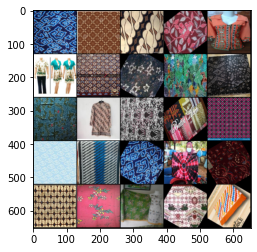

In [ ]:
# delacre dataset, dataloader, gen, crit
class Dataset(Dataset):
  def __init__(self, path, size=128, limit=10000):
    self.sizes = [size, size]
    items, labels = [], []
    for data in os.listdir(path)[:limit]:
      # path: './data/celeba/img_align_celeba'
      # data: 129880.JPG
      item = os.path.join(path, data)
      items.append(item)
      labels.append(data)
    self.items = items
    self.labels = labels
  def __len__(self):
    return len(self.items)
  def __getitem__(self, idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB') # 178x128
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128x128x3 (resized)
    data = np.transpose(data, (2, 0, 1)).astype(np.float32, copy=False) # 3x128x128 from 0 to 255
    data = torch.from_numpy(data).div(255) # from 0 to 1
    return data, self.labels[idx]
# dataset
data_path = './data/batik/Batik Dataset'
ds = Dataset(data_path, size=128, limit=10000)
# dataloader
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)
# models
gen = Generator(z_dim).to(device)
crit = Critic().to(device)
# optimizers
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5, 0.9))
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5, 0.9))
# initialization
# gen = gen.apply(init_weights)
# crit = crit.apply(init_weights)
# wandb optional
if(wandbact==1):
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x, y = next(iter(dataloader))
show(x)

In [ ]:
# gradient penalty calculation
def get_gp(real, fake, crit, alpha, gamma=10):
  mix_images = real * alpha + fake * (1-alpha) # 128x3x128x128
  mix_scores = crit(mix_images) # 128x1
  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs = torch.ones_like(mix_scores),
      retain_graph = True,
      create_graph = True
  )[0] #128x3x128x128
  gradient = gradient.view(len(gradient), -1) #128x49152
  gradient_norm = gradient.norm(2, dim=1)
  gp = gamma * ((gradient_norm-1) ** 2).mean()
  return gp

In [ ]:
# save & load checkpoints
root_path = './data/'
def save_checkpoint(name):
  #gen
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict()
  }, f"{root_path}G-{name}.pkl")
  #crit
  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict()
  }, f"{root_path}C-{name}.pkl")
  # print("checkpoint saved successfully")

def load_checkpoint(name):
  #gen
  checkpoint = torch.load(f"{root_path}G-{name}.pkl")
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])
  #crit
  checkpoint = torch.load(f"{root_path}C-{name}.pkl")
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])
  print("checkpoint loaded successfully")
  

In [ ]:
gen

Generator(
  (gen): Sequential(
    (0): ConvTranspose2d(200, 512, kernel_size=(4, 4), stride=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats

In [ ]:
# epoch=1
# save_checkpoint("test")

  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1 35
saving checkpoint 2 35
saving checkpoint 3 35
saving checkpoint 4 35
saving checkpoint 5 35
saving checkpoint 6 35
saving checkpoint 7 35
saving checkpoint 8 35
saving checkpoint 9 35
saving checkpoint 10 35
saving checkpoint 11 35
saving checkpoint 12 35
saving checkpoint 13 35
saving checkpoint 14 35
saving checkpoint 15 35
saving checkpoint 16 35
saving checkpoint 17 35
saving checkpoint 18 35
saving checkpoint 19 35
saving checkpoint 20 35
saving checkpoint 21 35
saving checkpoint 22 35
saving checkpoint 23 35
saving checkpoint 24 35
saving checkpoint 25 35
saving checkpoint 26 35
saving checkpoint 27 35
saving checkpoint 28 35
saving checkpoint 29 35
saving checkpoint 30 35
saving checkpoint 31 35
saving checkpoint 32 35
saving checkpoint 33 35
saving checkpoint 34 35


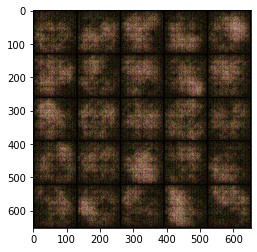

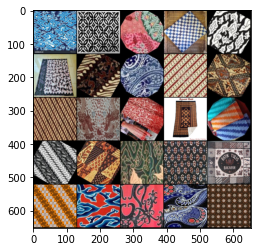

Epoch: 0: Step 35: Generator loss 6.097920698140348, Critic loss -1.6936669887815206


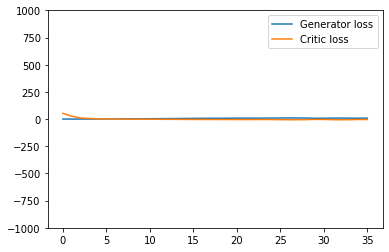

saving checkpoint 36 35
saving checkpoint 37 35
saving checkpoint 38 35
saving checkpoint 39 35
saving checkpoint 40 35
saving checkpoint 41 35
saving checkpoint 42 35
saving checkpoint 43 35
saving checkpoint 44 35
saving checkpoint 45 35
saving checkpoint 46 35
saving checkpoint 47 35
saving checkpoint 48 35
saving checkpoint 49 35
saving checkpoint 50 35
saving checkpoint 51 35
saving checkpoint 52 35
saving checkpoint 53 35
saving checkpoint 54 35
saving checkpoint 55 35
saving checkpoint 56 35
saving checkpoint 57 35
saving checkpoint 58 35
saving checkpoint 59 35
saving checkpoint 60 35
saving checkpoint 61 35
saving checkpoint 62 35
saving checkpoint 63 35
saving checkpoint 64 35
saving checkpoint 65 35
saving checkpoint 66 35
saving checkpoint 67 35
saving checkpoint 68 35
saving checkpoint 69 35


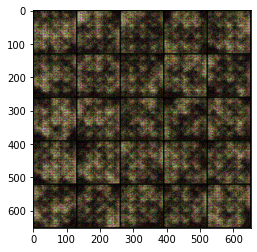

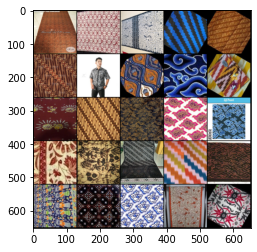

Epoch: 0: Step 70: Generator loss 14.49303001676287, Critic loss -11.105374142783027


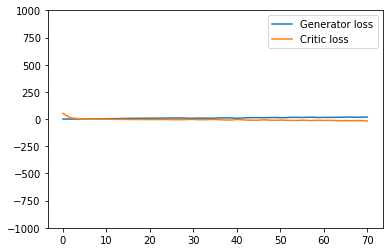

saving checkpoint 71 35
saving checkpoint 72 35
saving checkpoint 73 35
saving checkpoint 74 35
saving checkpoint 75 35
saving checkpoint 76 35
saving checkpoint 77 35
saving checkpoint 78 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 79 35
saving checkpoint 80 35
saving checkpoint 81 35
saving checkpoint 82 35
saving checkpoint 83 35
saving checkpoint 84 35
saving checkpoint 85 35
saving checkpoint 86 35
saving checkpoint 87 35
saving checkpoint 88 35
saving checkpoint 89 35
saving checkpoint 90 35
saving checkpoint 91 35
saving checkpoint 92 35
saving checkpoint 93 35
saving checkpoint 94 35
saving checkpoint 95 35
saving checkpoint 96 35
saving checkpoint 97 35
saving checkpoint 98 35
saving checkpoint 99 35
saving checkpoint 100 35
saving checkpoint 101 35
saving checkpoint 102 35
saving checkpoint 103 35
saving checkpoint 104 35


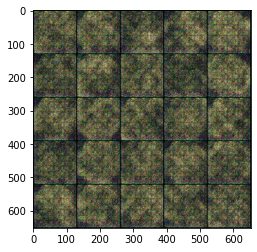

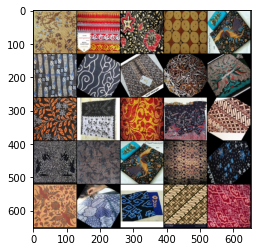

Epoch: 1: Step 105: Generator loss 19.280669021606446, Critic loss -18.721334975106373


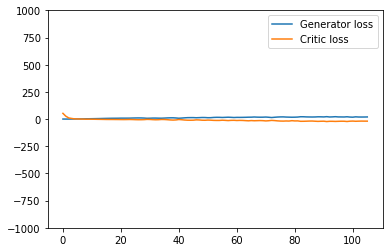

saving checkpoint 106 35
saving checkpoint 107 35
saving checkpoint 108 35
saving checkpoint 109 35
saving checkpoint 110 35
saving checkpoint 111 35
saving checkpoint 112 35
saving checkpoint 113 35
saving checkpoint 114 35
saving checkpoint 115 35
saving checkpoint 116 35
saving checkpoint 117 35
saving checkpoint 118 35
saving checkpoint 119 35
saving checkpoint 120 35
saving checkpoint 121 35
saving checkpoint 122 35
saving checkpoint 123 35
saving checkpoint 124 35
saving checkpoint 125 35
saving checkpoint 126 35
saving checkpoint 127 35
saving checkpoint 128 35
saving checkpoint 129 35
saving checkpoint 130 35
saving checkpoint 131 35
saving checkpoint 132 35
saving checkpoint 133 35
saving checkpoint 134 35
saving checkpoint 135 35
saving checkpoint 136 35
saving checkpoint 137 35
saving checkpoint 138 35
saving checkpoint 139 35


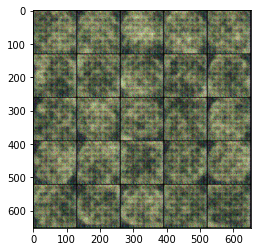

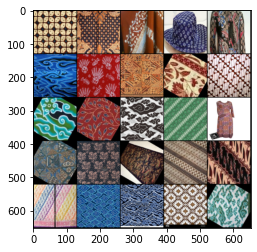

Epoch: 1: Step 140: Generator loss 19.95148811340332, Critic loss -19.88735073634556


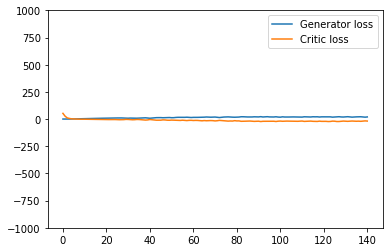

saving checkpoint 141 35
saving checkpoint 142 35
saving checkpoint 143 35
saving checkpoint 144 35
saving checkpoint 145 35
saving checkpoint 146 35
saving checkpoint 147 35
saving checkpoint 148 35
saving checkpoint 149 35
saving checkpoint 150 35
saving checkpoint 151 35
saving checkpoint 152 35
saving checkpoint 153 35
saving checkpoint 154 35
saving checkpoint 155 35
saving checkpoint 156 35
saving checkpoint 157 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 158 35
saving checkpoint 159 35
saving checkpoint 160 35
saving checkpoint 161 35
saving checkpoint 162 35
saving checkpoint 163 35
saving checkpoint 164 35
saving checkpoint 165 35
saving checkpoint 166 35
saving checkpoint 167 35
saving checkpoint 168 35
saving checkpoint 169 35
saving checkpoint 170 35
saving checkpoint 171 35
saving checkpoint 172 35
saving checkpoint 173 35
saving checkpoint 174 35


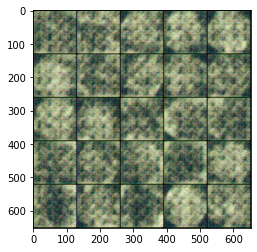

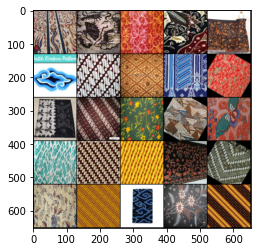

Epoch: 2: Step 175: Generator loss 21.083695275442942, Critic loss -17.40948550088065


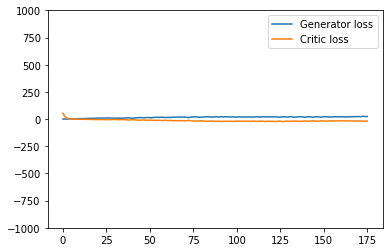

saving checkpoint 176 35
saving checkpoint 177 35
saving checkpoint 178 35
saving checkpoint 179 35
saving checkpoint 180 35
saving checkpoint 181 35
saving checkpoint 182 35
saving checkpoint 183 35
saving checkpoint 184 35
saving checkpoint 185 35
saving checkpoint 186 35
saving checkpoint 187 35
saving checkpoint 188 35
saving checkpoint 189 35
saving checkpoint 190 35
saving checkpoint 191 35
saving checkpoint 192 35
saving checkpoint 193 35
saving checkpoint 194 35
saving checkpoint 195 35
saving checkpoint 196 35
saving checkpoint 197 35
saving checkpoint 198 35
saving checkpoint 199 35
saving checkpoint 200 35
saving checkpoint 201 35
saving checkpoint 202 35
saving checkpoint 203 35
saving checkpoint 204 35
saving checkpoint 205 35
saving checkpoint 206 35
saving checkpoint 207 35
saving checkpoint 208 35
saving checkpoint 209 35


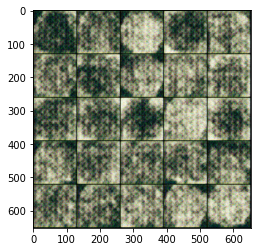

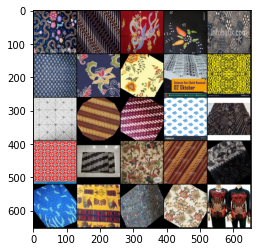

Epoch: 2: Step 210: Generator loss 26.51396996634347, Critic loss -19.942257614135737


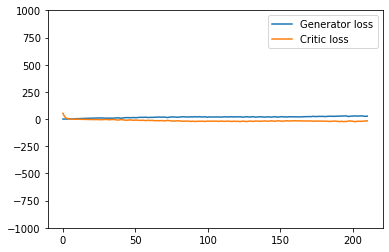

saving checkpoint 211 35
saving checkpoint 212 35
saving checkpoint 213 35
saving checkpoint 214 35
saving checkpoint 215 35
saving checkpoint 216 35
saving checkpoint 217 35
saving checkpoint 218 35
saving checkpoint 219 35
saving checkpoint 220 35
saving checkpoint 221 35
saving checkpoint 222 35
saving checkpoint 223 35
saving checkpoint 224 35
saving checkpoint 225 35
saving checkpoint 226 35
saving checkpoint 227 35
saving checkpoint 228 35
saving checkpoint 229 35
saving checkpoint 230 35
saving checkpoint 231 35
saving checkpoint 232 35
saving checkpoint 233 35
saving checkpoint 234 35
saving checkpoint 235 35
saving checkpoint 236 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 237 35
saving checkpoint 238 35
saving checkpoint 239 35
saving checkpoint 240 35
saving checkpoint 241 35
saving checkpoint 242 35
saving checkpoint 243 35
saving checkpoint 244 35


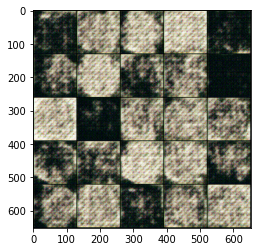

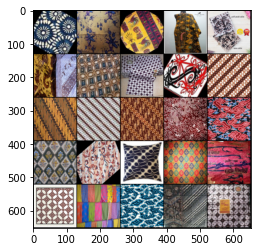

Epoch: 3: Step 245: Generator loss 21.88342214311872, Critic loss -16.485120707920622


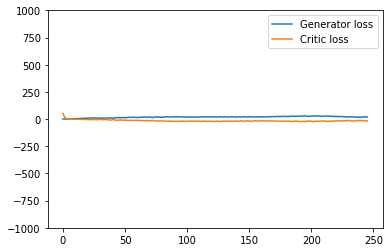

saving checkpoint 246 35
saving checkpoint 247 35
saving checkpoint 248 35
saving checkpoint 249 35
saving checkpoint 250 35
saving checkpoint 251 35
saving checkpoint 252 35
saving checkpoint 253 35
saving checkpoint 254 35
saving checkpoint 255 35
saving checkpoint 256 35
saving checkpoint 257 35
saving checkpoint 258 35
saving checkpoint 259 35
saving checkpoint 260 35
saving checkpoint 261 35
saving checkpoint 262 35
saving checkpoint 263 35
saving checkpoint 264 35
saving checkpoint 265 35
saving checkpoint 266 35
saving checkpoint 267 35
saving checkpoint 268 35
saving checkpoint 269 35
saving checkpoint 270 35
saving checkpoint 271 35
saving checkpoint 272 35
saving checkpoint 273 35
saving checkpoint 274 35
saving checkpoint 275 35
saving checkpoint 276 35
saving checkpoint 277 35
saving checkpoint 278 35
saving checkpoint 279 35


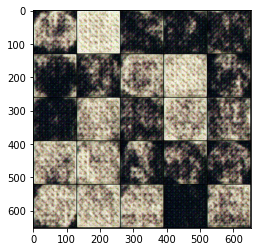

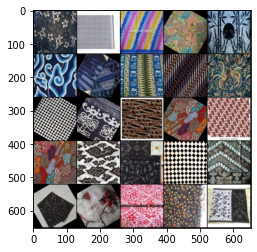

Epoch: 3: Step 280: Generator loss 16.3293486731393, Critic loss -13.740549752371647


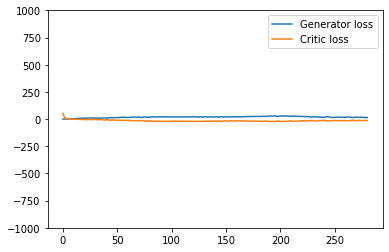

saving checkpoint 281 35
saving checkpoint 282 35
saving checkpoint 283 35
saving checkpoint 284 35
saving checkpoint 285 35
saving checkpoint 286 35
saving checkpoint 287 35
saving checkpoint 288 35
saving checkpoint 289 35
saving checkpoint 290 35
saving checkpoint 291 35
saving checkpoint 292 35
saving checkpoint 293 35
saving checkpoint 294 35
saving checkpoint 295 35
saving checkpoint 296 35
saving checkpoint 297 35
saving checkpoint 298 35
saving checkpoint 299 35
saving checkpoint 300 35
saving checkpoint 301 35
saving checkpoint 302 35
saving checkpoint 303 35
saving checkpoint 304 35
saving checkpoint 305 35
saving checkpoint 306 35
saving checkpoint 307 35
saving checkpoint 308 35
saving checkpoint 309 35
saving checkpoint 310 35
saving checkpoint 311 35
saving checkpoint 312 35
saving checkpoint 313 35
saving checkpoint 314 35


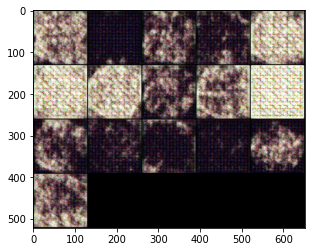

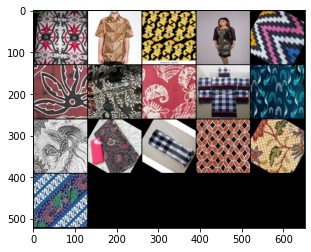

Epoch: 3: Step 315: Generator loss 15.659517342703683, Critic loss -13.21066349574498


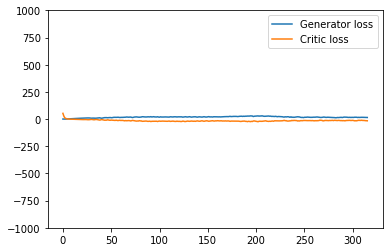

  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 316 35
saving checkpoint 317 35
saving checkpoint 318 35
saving checkpoint 319 35
saving checkpoint 320 35
saving checkpoint 321 35
saving checkpoint 322 35
saving checkpoint 323 35
saving checkpoint 324 35
saving checkpoint 325 35
saving checkpoint 326 35
saving checkpoint 327 35
saving checkpoint 328 35
saving checkpoint 329 35
saving checkpoint 330 35
saving checkpoint 331 35
saving checkpoint 332 35
saving checkpoint 333 35
saving checkpoint 334 35
saving checkpoint 335 35
saving checkpoint 336 35
saving checkpoint 337 35
saving checkpoint 338 35
saving checkpoint 339 35
saving checkpoint 340 35
saving checkpoint 341 35
saving checkpoint 342 35
saving checkpoint 343 35
saving checkpoint 344 35
saving checkpoint 345 35
saving checkpoint 346 35
saving checkpoint 347 35
saving checkpoint 348 35
saving checkpoint 349 35


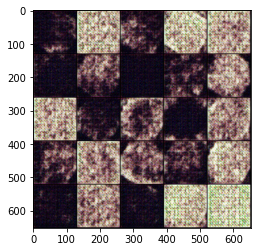

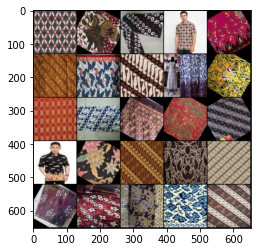

Epoch: 4: Step 350: Generator loss 16.622643171037947, Critic loss -12.414834341321672


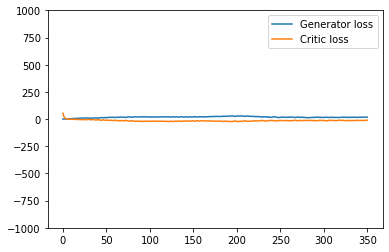

saving checkpoint 351 35
saving checkpoint 352 35
saving checkpoint 353 35
saving checkpoint 354 35
saving checkpoint 355 35
saving checkpoint 356 35
saving checkpoint 357 35
saving checkpoint 358 35
saving checkpoint 359 35
saving checkpoint 360 35
saving checkpoint 361 35
saving checkpoint 362 35
saving checkpoint 363 35
saving checkpoint 364 35
saving checkpoint 365 35
saving checkpoint 366 35
saving checkpoint 367 35
saving checkpoint 368 35
saving checkpoint 369 35
saving checkpoint 370 35
saving checkpoint 371 35
saving checkpoint 372 35
saving checkpoint 373 35
saving checkpoint 374 35
saving checkpoint 375 35
saving checkpoint 376 35
saving checkpoint 377 35
saving checkpoint 378 35
saving checkpoint 379 35
saving checkpoint 380 35
saving checkpoint 381 35
saving checkpoint 382 35
saving checkpoint 383 35
saving checkpoint 384 35


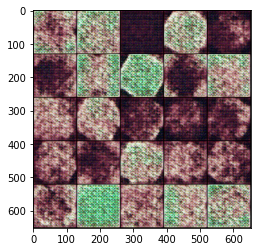

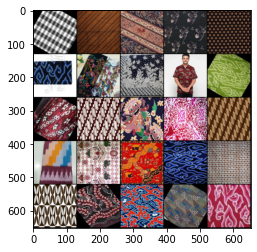

Epoch: 4: Step 385: Generator loss 19.41315073285784, Critic loss -13.195037896292549


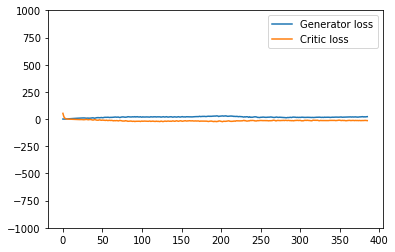

saving checkpoint 386 35
saving checkpoint 387 35
saving checkpoint 388 35
saving checkpoint 389 35
saving checkpoint 390 35
saving checkpoint 391 35
saving checkpoint 392 35
saving checkpoint 393 35
saving checkpoint 394 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 395 35
saving checkpoint 396 35
saving checkpoint 397 35
saving checkpoint 398 35
saving checkpoint 399 35
saving checkpoint 400 35
saving checkpoint 401 35
saving checkpoint 402 35
saving checkpoint 403 35
saving checkpoint 404 35
saving checkpoint 405 35
saving checkpoint 406 35
saving checkpoint 407 35
saving checkpoint 408 35
saving checkpoint 409 35
saving checkpoint 410 35
saving checkpoint 411 35
saving checkpoint 412 35
saving checkpoint 413 35
saving checkpoint 414 35
saving checkpoint 415 35
saving checkpoint 416 35
saving checkpoint 417 35
saving checkpoint 418 35
saving checkpoint 419 35


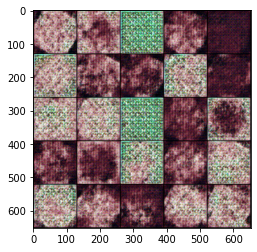

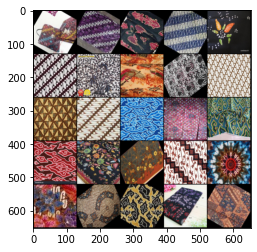

Epoch: 5: Step 420: Generator loss 21.313975524902343, Critic loss -12.597068413325717


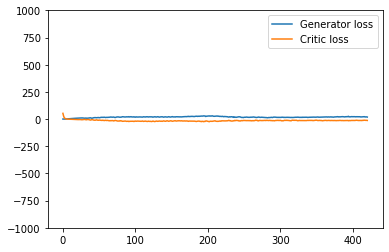

saving checkpoint 421 35
saving checkpoint 422 35
saving checkpoint 423 35
saving checkpoint 424 35
saving checkpoint 425 35
saving checkpoint 426 35
saving checkpoint 427 35
saving checkpoint 428 35
saving checkpoint 429 35
saving checkpoint 430 35
saving checkpoint 431 35
saving checkpoint 432 35
saving checkpoint 433 35
saving checkpoint 434 35
saving checkpoint 435 35
saving checkpoint 436 35
saving checkpoint 437 35
saving checkpoint 438 35
saving checkpoint 439 35
saving checkpoint 440 35
saving checkpoint 441 35
saving checkpoint 442 35
saving checkpoint 443 35
saving checkpoint 444 35
saving checkpoint 445 35
saving checkpoint 446 35
saving checkpoint 447 35
saving checkpoint 448 35
saving checkpoint 449 35
saving checkpoint 450 35
saving checkpoint 451 35
saving checkpoint 452 35
saving checkpoint 453 35
saving checkpoint 454 35


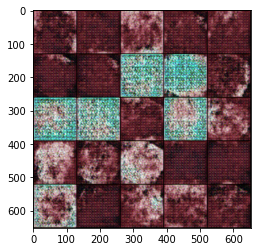

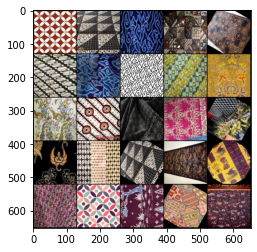

Epoch: 5: Step 455: Generator loss 21.180905478341238, Critic loss -12.36399130140032


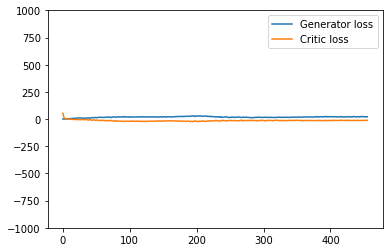

saving checkpoint 456 35
saving checkpoint 457 35
saving checkpoint 458 35
saving checkpoint 459 35
saving checkpoint 460 35
saving checkpoint 461 35
saving checkpoint 462 35
saving checkpoint 463 35
saving checkpoint 464 35
saving checkpoint 465 35
saving checkpoint 466 35
saving checkpoint 467 35
saving checkpoint 468 35
saving checkpoint 469 35
saving checkpoint 470 35
saving checkpoint 471 35
saving checkpoint 472 35
saving checkpoint 473 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 474 35
saving checkpoint 475 35
saving checkpoint 476 35
saving checkpoint 477 35
saving checkpoint 478 35
saving checkpoint 479 35
saving checkpoint 480 35
saving checkpoint 481 35
saving checkpoint 482 35
saving checkpoint 483 35
saving checkpoint 484 35
saving checkpoint 485 35
saving checkpoint 486 35
saving checkpoint 487 35
saving checkpoint 488 35
saving checkpoint 489 35


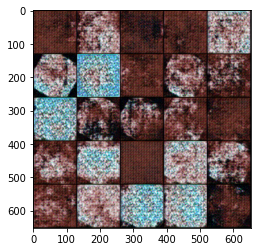

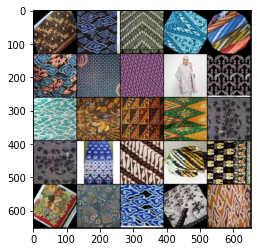

Epoch: 6: Step 490: Generator loss 21.297045625959125, Critic loss -11.512600054059714


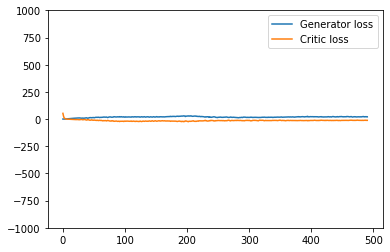

saving checkpoint 491 35
saving checkpoint 492 35
saving checkpoint 493 35
saving checkpoint 494 35
saving checkpoint 495 35
saving checkpoint 496 35
saving checkpoint 497 35
saving checkpoint 498 35
saving checkpoint 499 35
saving checkpoint 500 35
saving checkpoint 501 35
saving checkpoint 502 35
saving checkpoint 503 35
saving checkpoint 504 35
saving checkpoint 505 35
saving checkpoint 506 35
saving checkpoint 507 35
saving checkpoint 508 35
saving checkpoint 509 35
saving checkpoint 510 35
saving checkpoint 511 35
saving checkpoint 512 35
saving checkpoint 513 35
saving checkpoint 514 35
saving checkpoint 515 35
saving checkpoint 516 35
saving checkpoint 517 35
saving checkpoint 518 35
saving checkpoint 519 35
saving checkpoint 520 35
saving checkpoint 521 35
saving checkpoint 522 35
saving checkpoint 523 35
saving checkpoint 524 35


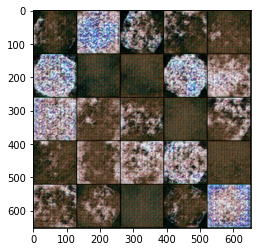

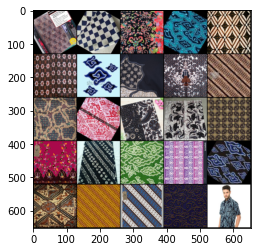

Epoch: 6: Step 525: Generator loss 22.36495579310826, Critic loss -11.947817638942174


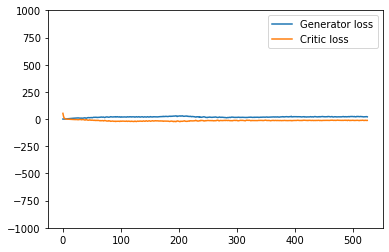

saving checkpoint 526 35
saving checkpoint 527 35
saving checkpoint 528 35
saving checkpoint 529 35
saving checkpoint 530 35
saving checkpoint 531 35
saving checkpoint 532 35
saving checkpoint 533 35
saving checkpoint 534 35
saving checkpoint 535 35
saving checkpoint 536 35
saving checkpoint 537 35
saving checkpoint 538 35
saving checkpoint 539 35
saving checkpoint 540 35
saving checkpoint 541 35
saving checkpoint 542 35
saving checkpoint 543 35
saving checkpoint 544 35
saving checkpoint 545 35
saving checkpoint 546 35
saving checkpoint 547 35
saving checkpoint 548 35
saving checkpoint 549 35
saving checkpoint 550 35
saving checkpoint 551 35
saving checkpoint 552 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 553 35
saving checkpoint 554 35
saving checkpoint 555 35
saving checkpoint 556 35
saving checkpoint 557 35
saving checkpoint 558 35
saving checkpoint 559 35


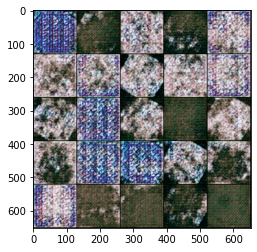

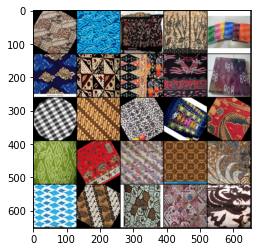

Epoch: 7: Step 560: Generator loss 22.290225056239535, Critic loss -11.877033312661307


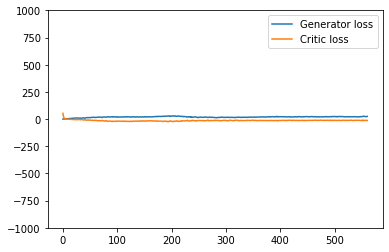

saving checkpoint 561 35
saving checkpoint 562 35
saving checkpoint 563 35
saving checkpoint 564 35
saving checkpoint 565 35
saving checkpoint 566 35
saving checkpoint 567 35
saving checkpoint 568 35
saving checkpoint 569 35
saving checkpoint 570 35
saving checkpoint 571 35
saving checkpoint 572 35
saving checkpoint 573 35
saving checkpoint 574 35
saving checkpoint 575 35
saving checkpoint 576 35
saving checkpoint 577 35
saving checkpoint 578 35
saving checkpoint 579 35
saving checkpoint 580 35
saving checkpoint 581 35
saving checkpoint 582 35
saving checkpoint 583 35
saving checkpoint 584 35
saving checkpoint 585 35
saving checkpoint 586 35
saving checkpoint 587 35
saving checkpoint 588 35
saving checkpoint 589 35
saving checkpoint 590 35
saving checkpoint 591 35
saving checkpoint 592 35
saving checkpoint 593 35
saving checkpoint 594 35


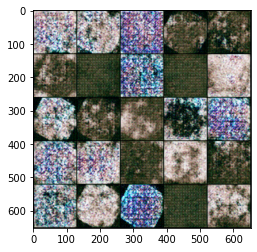

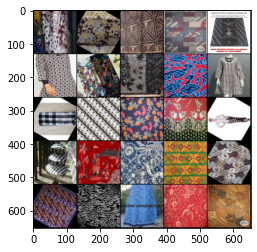

Epoch: 7: Step 595: Generator loss 22.28340890066964, Critic loss -11.831133583613804


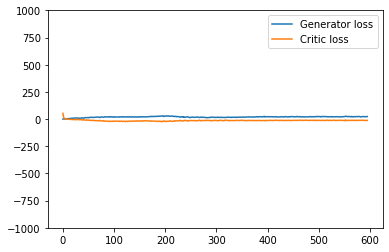

saving checkpoint 596 35
saving checkpoint 597 35
saving checkpoint 598 35
saving checkpoint 599 35
saving checkpoint 600 35
saving checkpoint 601 35
saving checkpoint 602 35
saving checkpoint 603 35
saving checkpoint 604 35
saving checkpoint 605 35
saving checkpoint 606 35
saving checkpoint 607 35
saving checkpoint 608 35
saving checkpoint 609 35
saving checkpoint 610 35
saving checkpoint 611 35
saving checkpoint 612 35
saving checkpoint 613 35
saving checkpoint 614 35
saving checkpoint 615 35
saving checkpoint 616 35
saving checkpoint 617 35
saving checkpoint 618 35
saving checkpoint 619 35
saving checkpoint 620 35
saving checkpoint 621 35
saving checkpoint 622 35
saving checkpoint 623 35
saving checkpoint 624 35
saving checkpoint 625 35
saving checkpoint 626 35
saving checkpoint 627 35
saving checkpoint 628 35
saving checkpoint 629 35


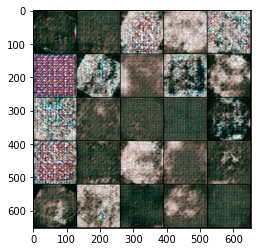

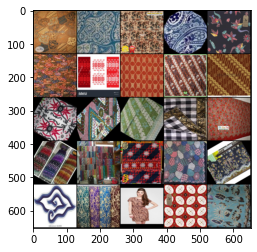

Epoch: 7: Step 630: Generator loss 23.02947256905692, Critic loss -10.90044981820243


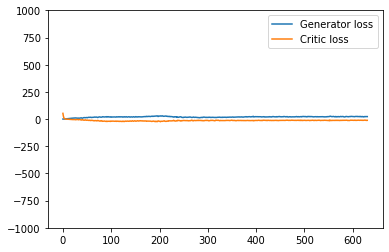

saving checkpoint 631 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 632 35
saving checkpoint 633 35
saving checkpoint 634 35
saving checkpoint 635 35
saving checkpoint 636 35
saving checkpoint 637 35
saving checkpoint 638 35
saving checkpoint 639 35
saving checkpoint 640 35
saving checkpoint 641 35
saving checkpoint 642 35
saving checkpoint 643 35
saving checkpoint 644 35
saving checkpoint 645 35
saving checkpoint 646 35
saving checkpoint 647 35
saving checkpoint 648 35
saving checkpoint 649 35
saving checkpoint 650 35
saving checkpoint 651 35
saving checkpoint 652 35
saving checkpoint 653 35
saving checkpoint 654 35
saving checkpoint 655 35
saving checkpoint 656 35
saving checkpoint 657 35
saving checkpoint 658 35
saving checkpoint 659 35
saving checkpoint 660 35
saving checkpoint 661 35
saving checkpoint 662 35
saving checkpoint 663 35
saving checkpoint 664 35


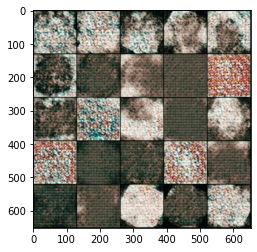

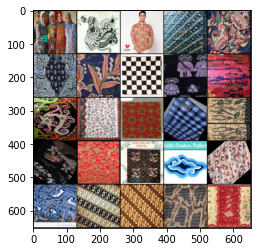

Epoch: 8: Step 665: Generator loss 23.229236929757253, Critic loss -11.600414425986152


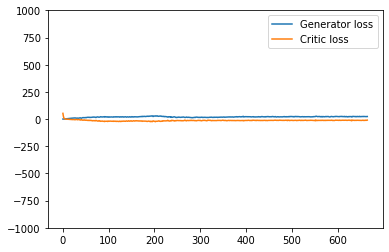

saving checkpoint 666 35
saving checkpoint 667 35
saving checkpoint 668 35
saving checkpoint 669 35
saving checkpoint 670 35
saving checkpoint 671 35
saving checkpoint 672 35
saving checkpoint 673 35
saving checkpoint 674 35
saving checkpoint 675 35
saving checkpoint 676 35
saving checkpoint 677 35
saving checkpoint 678 35
saving checkpoint 679 35
saving checkpoint 680 35
saving checkpoint 681 35
saving checkpoint 682 35
saving checkpoint 683 35
saving checkpoint 684 35
saving checkpoint 685 35
saving checkpoint 686 35
saving checkpoint 687 35
saving checkpoint 688 35
saving checkpoint 689 35
saving checkpoint 690 35
saving checkpoint 691 35
saving checkpoint 692 35
saving checkpoint 693 35
saving checkpoint 694 35
saving checkpoint 695 35
saving checkpoint 696 35
saving checkpoint 697 35
saving checkpoint 698 35
saving checkpoint 699 35


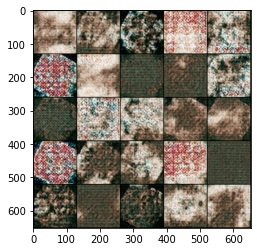

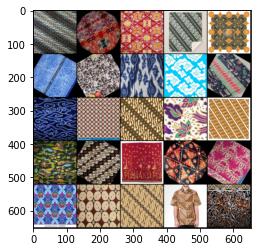

Epoch: 8: Step 700: Generator loss 23.788876124790736, Critic loss -11.240598836626328


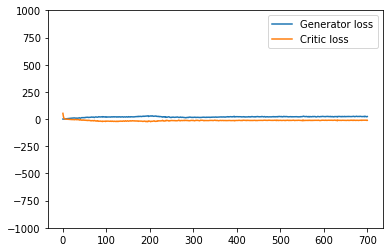

saving checkpoint 701 35
saving checkpoint 702 35
saving checkpoint 703 35
saving checkpoint 704 35
saving checkpoint 705 35
saving checkpoint 706 35
saving checkpoint 707 35
saving checkpoint 708 35
saving checkpoint 709 35
saving checkpoint 710 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 711 35
saving checkpoint 712 35
saving checkpoint 713 35
saving checkpoint 714 35
saving checkpoint 715 35
saving checkpoint 716 35
saving checkpoint 717 35
saving checkpoint 718 35
saving checkpoint 719 35
saving checkpoint 720 35
saving checkpoint 721 35
saving checkpoint 722 35
saving checkpoint 723 35
saving checkpoint 724 35
saving checkpoint 725 35
saving checkpoint 726 35
saving checkpoint 727 35
saving checkpoint 728 35
saving checkpoint 729 35
saving checkpoint 730 35
saving checkpoint 731 35
saving checkpoint 732 35
saving checkpoint 733 35
saving checkpoint 734 35


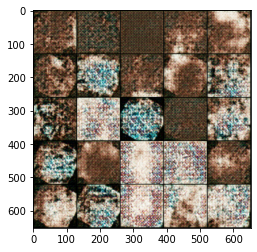

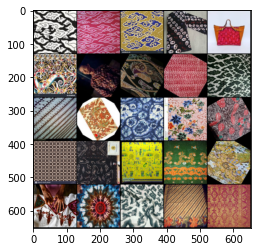

Epoch: 9: Step 735: Generator loss 23.773988832746234, Critic loss -10.722746688297814


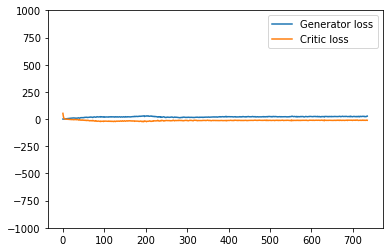

saving checkpoint 736 35
saving checkpoint 737 35
saving checkpoint 738 35
saving checkpoint 739 35
saving checkpoint 740 35
saving checkpoint 741 35
saving checkpoint 742 35
saving checkpoint 743 35
saving checkpoint 744 35
saving checkpoint 745 35
saving checkpoint 746 35
saving checkpoint 747 35
saving checkpoint 748 35
saving checkpoint 749 35
saving checkpoint 750 35
saving checkpoint 751 35
saving checkpoint 752 35
saving checkpoint 753 35
saving checkpoint 754 35
saving checkpoint 755 35
saving checkpoint 756 35
saving checkpoint 757 35
saving checkpoint 758 35
saving checkpoint 759 35
saving checkpoint 760 35
saving checkpoint 761 35
saving checkpoint 762 35
saving checkpoint 763 35
saving checkpoint 764 35
saving checkpoint 765 35
saving checkpoint 766 35
saving checkpoint 767 35
saving checkpoint 768 35
saving checkpoint 769 35


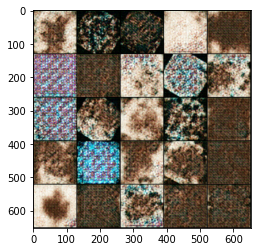

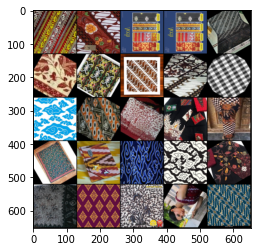

Epoch: 9: Step 770: Generator loss 23.62851611546108, Critic loss -11.263925699506485


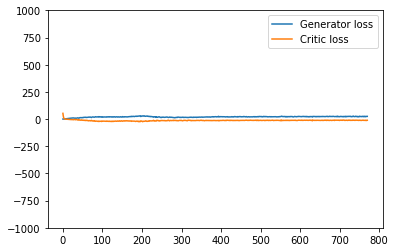

saving checkpoint 771 35
saving checkpoint 772 35
saving checkpoint 773 35
saving checkpoint 774 35
saving checkpoint 775 35
saving checkpoint 776 35
saving checkpoint 777 35
saving checkpoint 778 35
saving checkpoint 779 35
saving checkpoint 780 35
saving checkpoint 781 35
saving checkpoint 782 35
saving checkpoint 783 35
saving checkpoint 784 35
saving checkpoint 785 35
saving checkpoint 786 35
saving checkpoint 787 35
saving checkpoint 788 35
saving checkpoint 789 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 790 35
saving checkpoint 791 35
saving checkpoint 792 35
saving checkpoint 793 35
saving checkpoint 794 35
saving checkpoint 795 35
saving checkpoint 796 35
saving checkpoint 797 35
saving checkpoint 798 35
saving checkpoint 799 35
saving checkpoint 800 35
saving checkpoint 801 35
saving checkpoint 802 35
saving checkpoint 803 35
saving checkpoint 804 35


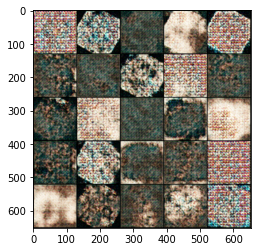

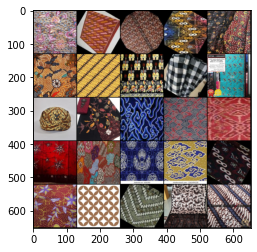

Epoch: 10: Step 805: Generator loss 25.12659705025809, Critic loss -11.462654478890554


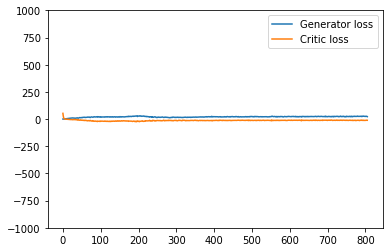

saving checkpoint 806 35
saving checkpoint 807 35
saving checkpoint 808 35
saving checkpoint 809 35
saving checkpoint 810 35
saving checkpoint 811 35
saving checkpoint 812 35
saving checkpoint 813 35
saving checkpoint 814 35
saving checkpoint 815 35
saving checkpoint 816 35
saving checkpoint 817 35
saving checkpoint 818 35
saving checkpoint 819 35
saving checkpoint 820 35
saving checkpoint 821 35
saving checkpoint 822 35
saving checkpoint 823 35
saving checkpoint 824 35
saving checkpoint 825 35
saving checkpoint 826 35
saving checkpoint 827 35
saving checkpoint 828 35
saving checkpoint 829 35
saving checkpoint 830 35
saving checkpoint 831 35
saving checkpoint 832 35
saving checkpoint 833 35
saving checkpoint 834 35
saving checkpoint 835 35
saving checkpoint 836 35
saving checkpoint 837 35
saving checkpoint 838 35
saving checkpoint 839 35


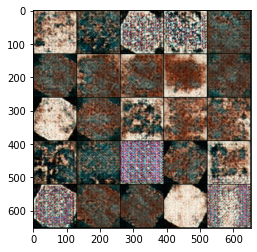

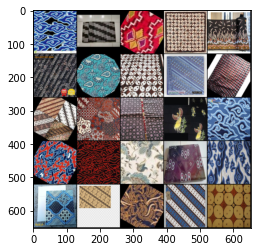

Epoch: 10: Step 840: Generator loss 24.30113830566406, Critic loss -11.310223157065257


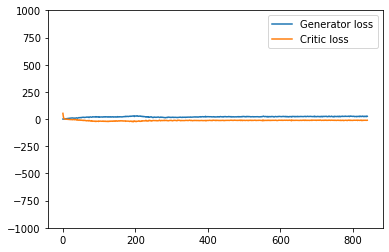

saving checkpoint 841 35
saving checkpoint 842 35
saving checkpoint 843 35
saving checkpoint 844 35
saving checkpoint 845 35
saving checkpoint 846 35
saving checkpoint 847 35
saving checkpoint 848 35
saving checkpoint 849 35
saving checkpoint 850 35
saving checkpoint 851 35
saving checkpoint 852 35
saving checkpoint 853 35
saving checkpoint 854 35
saving checkpoint 855 35
saving checkpoint 856 35
saving checkpoint 857 35
saving checkpoint 858 35
saving checkpoint 859 35
saving checkpoint 860 35
saving checkpoint 861 35
saving checkpoint 862 35
saving checkpoint 863 35
saving checkpoint 864 35
saving checkpoint 865 35
saving checkpoint 866 35
saving checkpoint 867 35
saving checkpoint 868 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 869 35
saving checkpoint 870 35
saving checkpoint 871 35
saving checkpoint 872 35
saving checkpoint 873 35
saving checkpoint 874 35


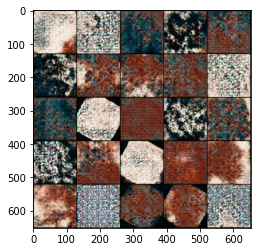

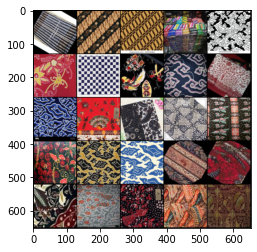

Epoch: 11: Step 875: Generator loss 24.893599537440707, Critic loss -11.177297346932546


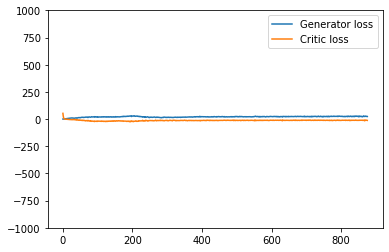

saving checkpoint 876 35
saving checkpoint 877 35
saving checkpoint 878 35
saving checkpoint 879 35
saving checkpoint 880 35
saving checkpoint 881 35
saving checkpoint 882 35
saving checkpoint 883 35
saving checkpoint 884 35
saving checkpoint 885 35
saving checkpoint 886 35
saving checkpoint 887 35
saving checkpoint 888 35
saving checkpoint 889 35
saving checkpoint 890 35
saving checkpoint 891 35
saving checkpoint 892 35
saving checkpoint 893 35
saving checkpoint 894 35
saving checkpoint 895 35
saving checkpoint 896 35
saving checkpoint 897 35
saving checkpoint 898 35
saving checkpoint 899 35
saving checkpoint 900 35
saving checkpoint 901 35
saving checkpoint 902 35
saving checkpoint 903 35
saving checkpoint 904 35
saving checkpoint 905 35
saving checkpoint 906 35
saving checkpoint 907 35
saving checkpoint 908 35
saving checkpoint 909 35


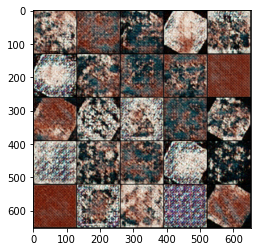

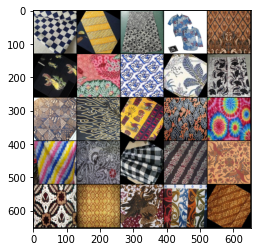

Epoch: 11: Step 910: Generator loss 25.784792491367885, Critic loss -11.193747318812779


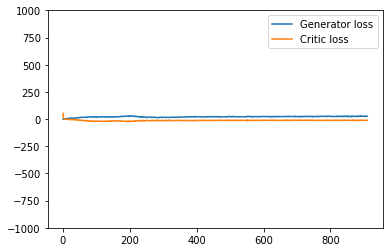

saving checkpoint 911 35
saving checkpoint 912 35
saving checkpoint 913 35
saving checkpoint 914 35
saving checkpoint 915 35
saving checkpoint 916 35
saving checkpoint 917 35
saving checkpoint 918 35
saving checkpoint 919 35
saving checkpoint 920 35
saving checkpoint 921 35
saving checkpoint 922 35
saving checkpoint 923 35
saving checkpoint 924 35
saving checkpoint 925 35
saving checkpoint 926 35
saving checkpoint 927 35
saving checkpoint 928 35
saving checkpoint 929 35
saving checkpoint 930 35
saving checkpoint 931 35
saving checkpoint 932 35
saving checkpoint 933 35
saving checkpoint 934 35
saving checkpoint 935 35
saving checkpoint 936 35
saving checkpoint 937 35
saving checkpoint 938 35
saving checkpoint 939 35
saving checkpoint 940 35
saving checkpoint 941 35
saving checkpoint 942 35
saving checkpoint 943 35
saving checkpoint 944 35


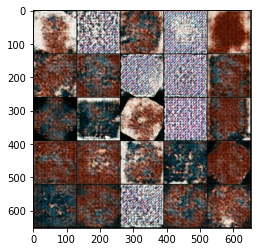

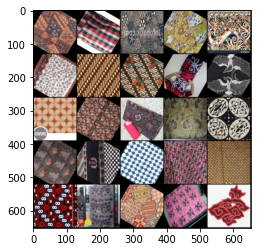

Epoch: 11: Step 945: Generator loss 26.559374945504324, Critic loss -10.965570387159076


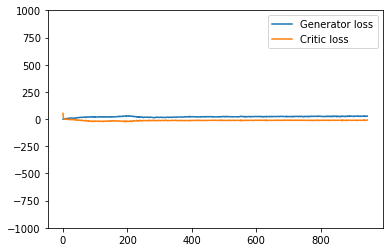

saving checkpoint 946 35
saving checkpoint 947 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 948 35
saving checkpoint 949 35
saving checkpoint 950 35
saving checkpoint 951 35
saving checkpoint 952 35
saving checkpoint 953 35
saving checkpoint 954 35
saving checkpoint 955 35
saving checkpoint 956 35
saving checkpoint 957 35
saving checkpoint 958 35
saving checkpoint 959 35
saving checkpoint 960 35
saving checkpoint 961 35
saving checkpoint 962 35
saving checkpoint 963 35
saving checkpoint 964 35
saving checkpoint 965 35
saving checkpoint 966 35
saving checkpoint 967 35
saving checkpoint 968 35
saving checkpoint 969 35
saving checkpoint 970 35
saving checkpoint 971 35
saving checkpoint 972 35
saving checkpoint 973 35
saving checkpoint 974 35
saving checkpoint 975 35
saving checkpoint 976 35
saving checkpoint 977 35
saving checkpoint 978 35
saving checkpoint 979 35


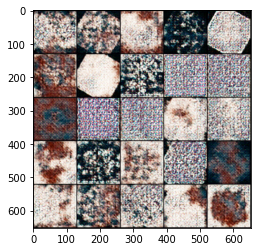

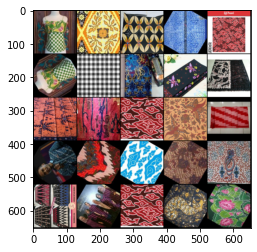

Epoch: 12: Step 980: Generator loss 26.906753594534738, Critic loss -10.894410329546249


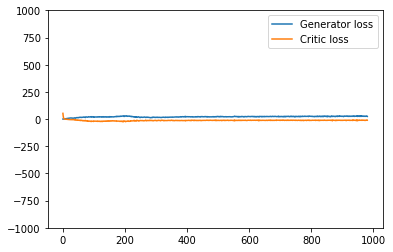

saving checkpoint 981 35
saving checkpoint 982 35
saving checkpoint 983 35
saving checkpoint 984 35
saving checkpoint 985 35
saving checkpoint 986 35
saving checkpoint 987 35
saving checkpoint 988 35
saving checkpoint 989 35
saving checkpoint 990 35
saving checkpoint 991 35
saving checkpoint 992 35
saving checkpoint 993 35
saving checkpoint 994 35
saving checkpoint 995 35
saving checkpoint 996 35
saving checkpoint 997 35
saving checkpoint 998 35
saving checkpoint 999 35
saving checkpoint 1000 35
saving checkpoint 1001 35
saving checkpoint 1002 35
saving checkpoint 1003 35
saving checkpoint 1004 35
saving checkpoint 1005 35
saving checkpoint 1006 35
saving checkpoint 1007 35
saving checkpoint 1008 35
saving checkpoint 1009 35
saving checkpoint 1010 35
saving checkpoint 1011 35
saving checkpoint 1012 35
saving checkpoint 1013 35
saving checkpoint 1014 35


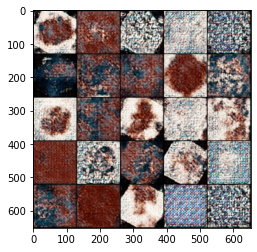

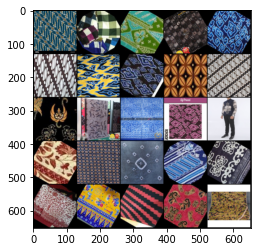

Epoch: 12: Step 1015: Generator loss 27.7621038709368, Critic loss -11.036242760249548


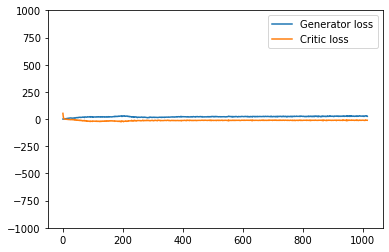

saving checkpoint 1016 35
saving checkpoint 1017 35
saving checkpoint 1018 35
saving checkpoint 1019 35
saving checkpoint 1020 35
saving checkpoint 1021 35
saving checkpoint 1022 35
saving checkpoint 1023 35
saving checkpoint 1024 35
saving checkpoint 1025 35
saving checkpoint 1026 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1027 35
saving checkpoint 1028 35
saving checkpoint 1029 35
saving checkpoint 1030 35
saving checkpoint 1031 35
saving checkpoint 1032 35
saving checkpoint 1033 35
saving checkpoint 1034 35
saving checkpoint 1035 35
saving checkpoint 1036 35
saving checkpoint 1037 35
saving checkpoint 1038 35
saving checkpoint 1039 35
saving checkpoint 1040 35
saving checkpoint 1041 35
saving checkpoint 1042 35
saving checkpoint 1043 35
saving checkpoint 1044 35
saving checkpoint 1045 35
saving checkpoint 1046 35
saving checkpoint 1047 35
saving checkpoint 1048 35
saving checkpoint 1049 35


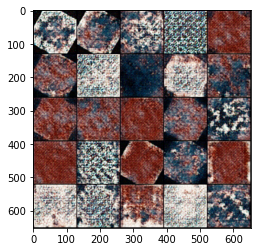

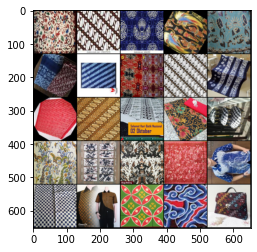

Epoch: 13: Step 1050: Generator loss 27.995814786638533, Critic loss -10.664222041538782


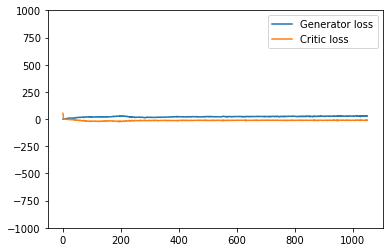

saving checkpoint 1051 35
saving checkpoint 1052 35
saving checkpoint 1053 35
saving checkpoint 1054 35
saving checkpoint 1055 35
saving checkpoint 1056 35
saving checkpoint 1057 35
saving checkpoint 1058 35
saving checkpoint 1059 35
saving checkpoint 1060 35
saving checkpoint 1061 35
saving checkpoint 1062 35
saving checkpoint 1063 35
saving checkpoint 1064 35
saving checkpoint 1065 35
saving checkpoint 1066 35
saving checkpoint 1067 35
saving checkpoint 1068 35
saving checkpoint 1069 35
saving checkpoint 1070 35
saving checkpoint 1071 35
saving checkpoint 1072 35
saving checkpoint 1073 35
saving checkpoint 1074 35
saving checkpoint 1075 35
saving checkpoint 1076 35
saving checkpoint 1077 35
saving checkpoint 1078 35
saving checkpoint 1079 35
saving checkpoint 1080 35
saving checkpoint 1081 35
saving checkpoint 1082 35
saving checkpoint 1083 35
saving checkpoint 1084 35


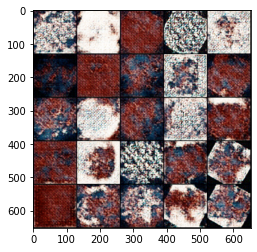

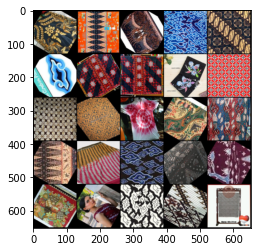

Epoch: 13: Step 1085: Generator loss 28.191744450160435, Critic loss -10.708766602107458


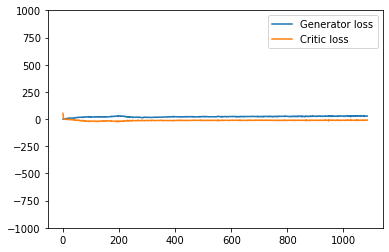

saving checkpoint 1086 35
saving checkpoint 1087 35
saving checkpoint 1088 35
saving checkpoint 1089 35
saving checkpoint 1090 35
saving checkpoint 1091 35
saving checkpoint 1092 35
saving checkpoint 1093 35
saving checkpoint 1094 35
saving checkpoint 1095 35
saving checkpoint 1096 35
saving checkpoint 1097 35
saving checkpoint 1098 35
saving checkpoint 1099 35
saving checkpoint 1100 35
saving checkpoint 1101 35
saving checkpoint 1102 35
saving checkpoint 1103 35
saving checkpoint 1104 35
saving checkpoint 1105 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1106 35
saving checkpoint 1107 35
saving checkpoint 1108 35
saving checkpoint 1109 35
saving checkpoint 1110 35
saving checkpoint 1111 35
saving checkpoint 1112 35
saving checkpoint 1113 35
saving checkpoint 1114 35
saving checkpoint 1115 35
saving checkpoint 1116 35
saving checkpoint 1117 35
saving checkpoint 1118 35
saving checkpoint 1119 35


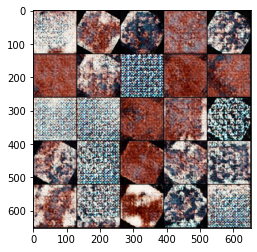

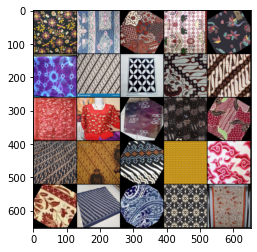

Epoch: 14: Step 1120: Generator loss 28.037240873064313, Critic loss -9.901932877131873


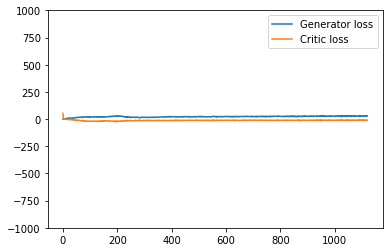

saving checkpoint 1121 35
saving checkpoint 1122 35
saving checkpoint 1123 35
saving checkpoint 1124 35
saving checkpoint 1125 35
saving checkpoint 1126 35
saving checkpoint 1127 35
saving checkpoint 1128 35
saving checkpoint 1129 35
saving checkpoint 1130 35
saving checkpoint 1131 35
saving checkpoint 1132 35
saving checkpoint 1133 35
saving checkpoint 1134 35
saving checkpoint 1135 35
saving checkpoint 1136 35
saving checkpoint 1137 35
saving checkpoint 1138 35
saving checkpoint 1139 35
saving checkpoint 1140 35
saving checkpoint 1141 35
saving checkpoint 1142 35
saving checkpoint 1143 35
saving checkpoint 1144 35
saving checkpoint 1145 35
saving checkpoint 1146 35
saving checkpoint 1147 35
saving checkpoint 1148 35
saving checkpoint 1149 35
saving checkpoint 1150 35
saving checkpoint 1151 35
saving checkpoint 1152 35
saving checkpoint 1153 35
saving checkpoint 1154 35


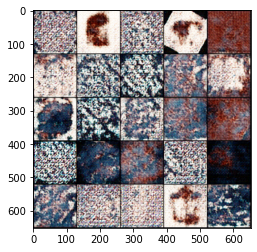

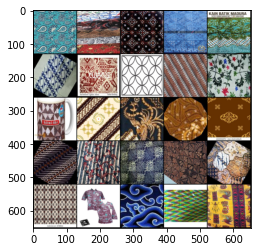

Epoch: 14: Step 1155: Generator loss 28.161537660871232, Critic loss -10.255471458435059


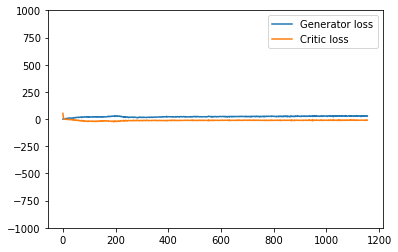

saving checkpoint 1156 35
saving checkpoint 1157 35
saving checkpoint 1158 35
saving checkpoint 1159 35
saving checkpoint 1160 35
saving checkpoint 1161 35
saving checkpoint 1162 35
saving checkpoint 1163 35
saving checkpoint 1164 35
saving checkpoint 1165 35
saving checkpoint 1166 35
saving checkpoint 1167 35
saving checkpoint 1168 35
saving checkpoint 1169 35
saving checkpoint 1170 35
saving checkpoint 1171 35
saving checkpoint 1172 35
saving checkpoint 1173 35
saving checkpoint 1174 35
saving checkpoint 1175 35
saving checkpoint 1176 35
saving checkpoint 1177 35
saving checkpoint 1178 35
saving checkpoint 1179 35
saving checkpoint 1180 35
saving checkpoint 1181 35
saving checkpoint 1182 35
saving checkpoint 1183 35
saving checkpoint 1184 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1185 35
saving checkpoint 1186 35
saving checkpoint 1187 35
saving checkpoint 1188 35
saving checkpoint 1189 35


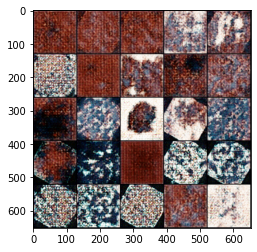

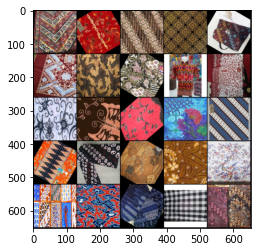

Epoch: 15: Step 1190: Generator loss 28.65100806100028, Critic loss -10.90830307824271


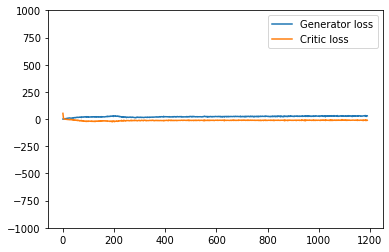

saving checkpoint 1191 35
saving checkpoint 1192 35
saving checkpoint 1193 35
saving checkpoint 1194 35
saving checkpoint 1195 35
saving checkpoint 1196 35
saving checkpoint 1197 35
saving checkpoint 1198 35
saving checkpoint 1199 35
saving checkpoint 1200 35
saving checkpoint 1201 35
saving checkpoint 1202 35
saving checkpoint 1203 35
saving checkpoint 1204 35
saving checkpoint 1205 35
saving checkpoint 1206 35
saving checkpoint 1207 35
saving checkpoint 1208 35
saving checkpoint 1209 35
saving checkpoint 1210 35
saving checkpoint 1211 35
saving checkpoint 1212 35
saving checkpoint 1213 35
saving checkpoint 1214 35
saving checkpoint 1215 35
saving checkpoint 1216 35
saving checkpoint 1217 35
saving checkpoint 1218 35
saving checkpoint 1219 35
saving checkpoint 1220 35
saving checkpoint 1221 35
saving checkpoint 1222 35
saving checkpoint 1223 35
saving checkpoint 1224 35


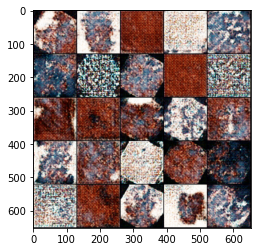

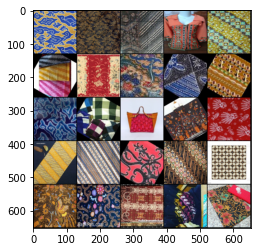

Epoch: 15: Step 1225: Generator loss 28.529946735927037, Critic loss -10.539261368342808


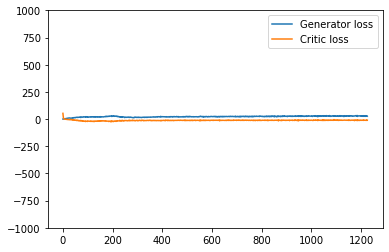

saving checkpoint 1226 35
saving checkpoint 1227 35
saving checkpoint 1228 35
saving checkpoint 1229 35
saving checkpoint 1230 35
saving checkpoint 1231 35
saving checkpoint 1232 35
saving checkpoint 1233 35
saving checkpoint 1234 35
saving checkpoint 1235 35
saving checkpoint 1236 35
saving checkpoint 1237 35
saving checkpoint 1238 35
saving checkpoint 1239 35
saving checkpoint 1240 35
saving checkpoint 1241 35
saving checkpoint 1242 35
saving checkpoint 1243 35
saving checkpoint 1244 35
saving checkpoint 1245 35
saving checkpoint 1246 35
saving checkpoint 1247 35
saving checkpoint 1248 35
saving checkpoint 1249 35
saving checkpoint 1250 35
saving checkpoint 1251 35
saving checkpoint 1252 35
saving checkpoint 1253 35
saving checkpoint 1254 35
saving checkpoint 1255 35
saving checkpoint 1256 35
saving checkpoint 1257 35
saving checkpoint 1258 35
saving checkpoint 1259 35


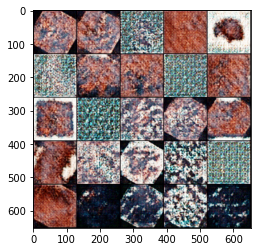

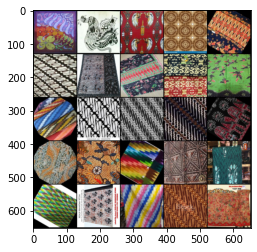

Epoch: 15: Step 1260: Generator loss 27.233974838256835, Critic loss -10.187215439932686


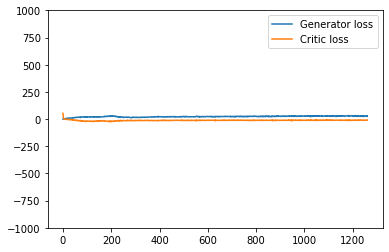

saving checkpoint 1261 35
saving checkpoint 1262 35
saving checkpoint 1263 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1264 35
saving checkpoint 1265 35
saving checkpoint 1266 35
saving checkpoint 1267 35
saving checkpoint 1268 35
saving checkpoint 1269 35
saving checkpoint 1270 35
saving checkpoint 1271 35
saving checkpoint 1272 35
saving checkpoint 1273 35
saving checkpoint 1274 35
saving checkpoint 1275 35
saving checkpoint 1276 35
saving checkpoint 1277 35
saving checkpoint 1278 35
saving checkpoint 1279 35
saving checkpoint 1280 35
saving checkpoint 1281 35
saving checkpoint 1282 35
saving checkpoint 1283 35
saving checkpoint 1284 35
saving checkpoint 1285 35
saving checkpoint 1286 35
saving checkpoint 1287 35
saving checkpoint 1288 35
saving checkpoint 1289 35
saving checkpoint 1290 35
saving checkpoint 1291 35
saving checkpoint 1292 35
saving checkpoint 1293 35
saving checkpoint 1294 35


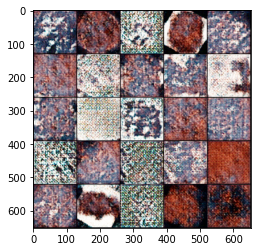

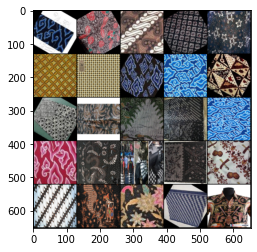

Epoch: 16: Step 1295: Generator loss 27.981354359218052, Critic loss -10.402111399514334


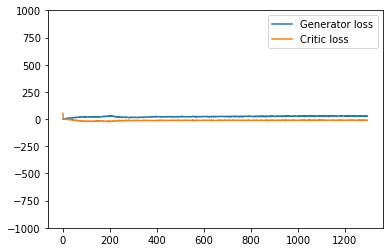

saving checkpoint 1296 35
saving checkpoint 1297 35
saving checkpoint 1298 35
saving checkpoint 1299 35
saving checkpoint 1300 35
saving checkpoint 1301 35
saving checkpoint 1302 35
saving checkpoint 1303 35
saving checkpoint 1304 35
saving checkpoint 1305 35
saving checkpoint 1306 35
saving checkpoint 1307 35
saving checkpoint 1308 35
saving checkpoint 1309 35
saving checkpoint 1310 35
saving checkpoint 1311 35
saving checkpoint 1312 35
saving checkpoint 1313 35
saving checkpoint 1314 35
saving checkpoint 1315 35
saving checkpoint 1316 35
saving checkpoint 1317 35
saving checkpoint 1318 35
saving checkpoint 1319 35
saving checkpoint 1320 35
saving checkpoint 1321 35
saving checkpoint 1322 35
saving checkpoint 1323 35
saving checkpoint 1324 35
saving checkpoint 1325 35
saving checkpoint 1326 35
saving checkpoint 1327 35
saving checkpoint 1328 35
saving checkpoint 1329 35


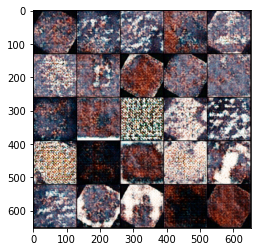

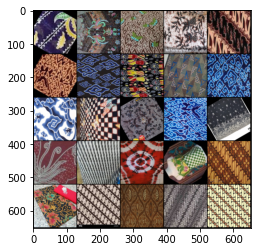

Epoch: 16: Step 1330: Generator loss 27.35519583565848, Critic loss -10.467908385140555


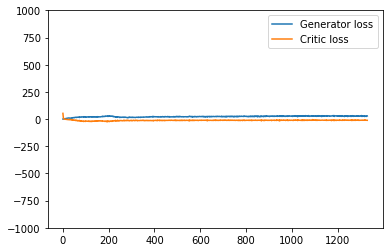

saving checkpoint 1331 35
saving checkpoint 1332 35
saving checkpoint 1333 35
saving checkpoint 1334 35
saving checkpoint 1335 35
saving checkpoint 1336 35
saving checkpoint 1337 35
saving checkpoint 1338 35
saving checkpoint 1339 35
saving checkpoint 1340 35
saving checkpoint 1341 35
saving checkpoint 1342 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1343 35
saving checkpoint 1344 35
saving checkpoint 1345 35
saving checkpoint 1346 35
saving checkpoint 1347 35
saving checkpoint 1348 35
saving checkpoint 1349 35
saving checkpoint 1350 35
saving checkpoint 1351 35
saving checkpoint 1352 35
saving checkpoint 1353 35
saving checkpoint 1354 35
saving checkpoint 1355 35
saving checkpoint 1356 35
saving checkpoint 1357 35
saving checkpoint 1358 35
saving checkpoint 1359 35
saving checkpoint 1360 35
saving checkpoint 1361 35
saving checkpoint 1362 35
saving checkpoint 1363 35
saving checkpoint 1364 35


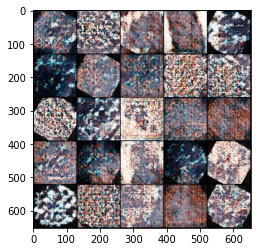

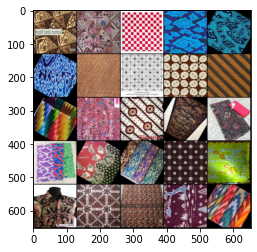

Epoch: 17: Step 1365: Generator loss 27.233226830618722, Critic loss -10.234704527173722


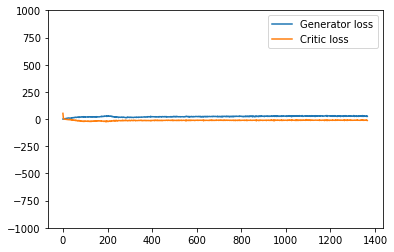

saving checkpoint 1366 35
saving checkpoint 1367 35
saving checkpoint 1368 35
saving checkpoint 1369 35
saving checkpoint 1370 35
saving checkpoint 1371 35
saving checkpoint 1372 35
saving checkpoint 1373 35
saving checkpoint 1374 35
saving checkpoint 1375 35
saving checkpoint 1376 35
saving checkpoint 1377 35
saving checkpoint 1378 35
saving checkpoint 1379 35
saving checkpoint 1380 35
saving checkpoint 1381 35
saving checkpoint 1382 35
saving checkpoint 1383 35
saving checkpoint 1384 35
saving checkpoint 1385 35
saving checkpoint 1386 35
saving checkpoint 1387 35
saving checkpoint 1388 35
saving checkpoint 1389 35
saving checkpoint 1390 35
saving checkpoint 1391 35
saving checkpoint 1392 35
saving checkpoint 1393 35
saving checkpoint 1394 35
saving checkpoint 1395 35
saving checkpoint 1396 35
saving checkpoint 1397 35
saving checkpoint 1398 35
saving checkpoint 1399 35


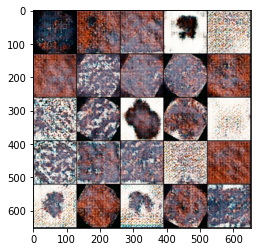

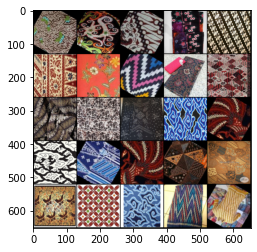

Epoch: 17: Step 1400: Generator loss 27.8288272857666, Critic loss -10.52630192075457


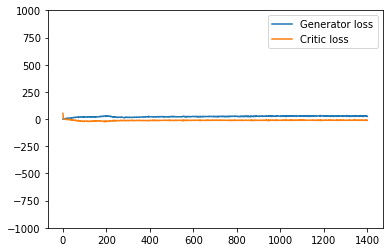

saving checkpoint 1401 35
saving checkpoint 1402 35
saving checkpoint 1403 35
saving checkpoint 1404 35
saving checkpoint 1405 35
saving checkpoint 1406 35
saving checkpoint 1407 35
saving checkpoint 1408 35
saving checkpoint 1409 35
saving checkpoint 1410 35
saving checkpoint 1411 35
saving checkpoint 1412 35
saving checkpoint 1413 35
saving checkpoint 1414 35
saving checkpoint 1415 35
saving checkpoint 1416 35
saving checkpoint 1417 35
saving checkpoint 1418 35
saving checkpoint 1419 35
saving checkpoint 1420 35
saving checkpoint 1421 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1422 35
saving checkpoint 1423 35
saving checkpoint 1424 35
saving checkpoint 1425 35
saving checkpoint 1426 35
saving checkpoint 1427 35
saving checkpoint 1428 35
saving checkpoint 1429 35
saving checkpoint 1430 35
saving checkpoint 1431 35
saving checkpoint 1432 35
saving checkpoint 1433 35
saving checkpoint 1434 35


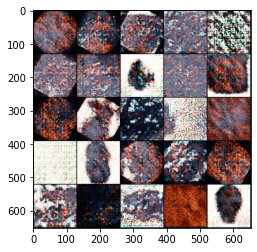

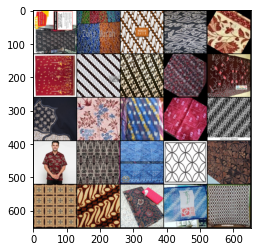

Epoch: 18: Step 1435: Generator loss 28.690206691196988, Critic loss -10.813513935634068


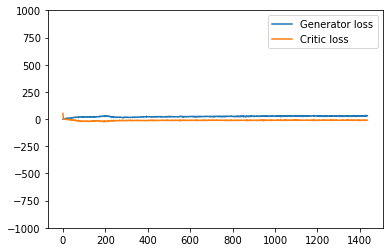

saving checkpoint 1436 35
saving checkpoint 1437 35
saving checkpoint 1438 35
saving checkpoint 1439 35
saving checkpoint 1440 35
saving checkpoint 1441 35
saving checkpoint 1442 35
saving checkpoint 1443 35
saving checkpoint 1444 35
saving checkpoint 1445 35
saving checkpoint 1446 35
saving checkpoint 1447 35
saving checkpoint 1448 35
saving checkpoint 1449 35
saving checkpoint 1450 35
saving checkpoint 1451 35
saving checkpoint 1452 35
saving checkpoint 1453 35
saving checkpoint 1454 35
saving checkpoint 1455 35
saving checkpoint 1456 35
saving checkpoint 1457 35
saving checkpoint 1458 35
saving checkpoint 1459 35
saving checkpoint 1460 35
saving checkpoint 1461 35
saving checkpoint 1462 35
saving checkpoint 1463 35
saving checkpoint 1464 35
saving checkpoint 1465 35
saving checkpoint 1466 35
saving checkpoint 1467 35
saving checkpoint 1468 35
saving checkpoint 1469 35


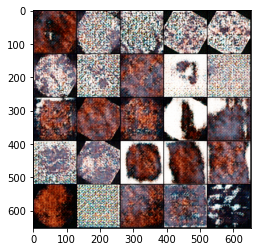

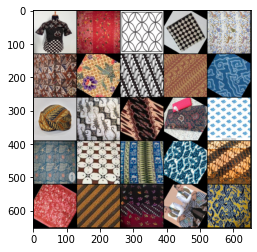

Epoch: 18: Step 1470: Generator loss 28.459915924072266, Critic loss -10.594054807935441


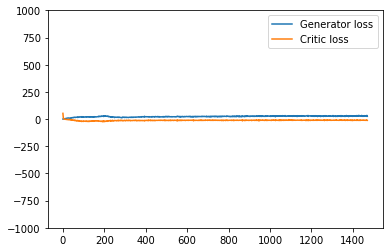

saving checkpoint 1471 35
saving checkpoint 1472 35
saving checkpoint 1473 35
saving checkpoint 1474 35
saving checkpoint 1475 35
saving checkpoint 1476 35
saving checkpoint 1477 35
saving checkpoint 1478 35
saving checkpoint 1479 35
saving checkpoint 1480 35
saving checkpoint 1481 35
saving checkpoint 1482 35
saving checkpoint 1483 35
saving checkpoint 1484 35
saving checkpoint 1485 35
saving checkpoint 1486 35
saving checkpoint 1487 35
saving checkpoint 1488 35
saving checkpoint 1489 35
saving checkpoint 1490 35
saving checkpoint 1491 35
saving checkpoint 1492 35
saving checkpoint 1493 35
saving checkpoint 1494 35
saving checkpoint 1495 35
saving checkpoint 1496 35
saving checkpoint 1497 35
saving checkpoint 1498 35
saving checkpoint 1499 35
saving checkpoint 1500 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1501 35
saving checkpoint 1502 35
saving checkpoint 1503 35
saving checkpoint 1504 35


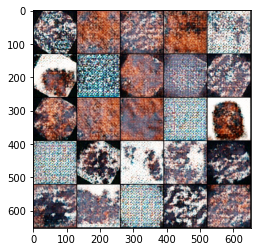

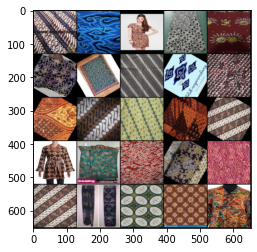

Epoch: 19: Step 1505: Generator loss 28.401420211791994, Critic loss -10.299187578473772


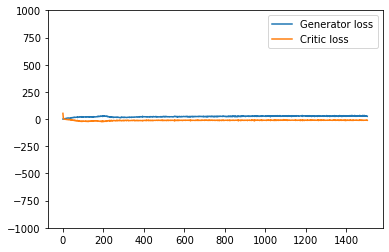

saving checkpoint 1506 35
saving checkpoint 1507 35
saving checkpoint 1508 35
saving checkpoint 1509 35
saving checkpoint 1510 35
saving checkpoint 1511 35
saving checkpoint 1512 35
saving checkpoint 1513 35
saving checkpoint 1514 35
saving checkpoint 1515 35
saving checkpoint 1516 35
saving checkpoint 1517 35
saving checkpoint 1518 35
saving checkpoint 1519 35
saving checkpoint 1520 35
saving checkpoint 1521 35
saving checkpoint 1522 35
saving checkpoint 1523 35
saving checkpoint 1524 35
saving checkpoint 1525 35
saving checkpoint 1526 35
saving checkpoint 1527 35
saving checkpoint 1528 35
saving checkpoint 1529 35
saving checkpoint 1530 35
saving checkpoint 1531 35
saving checkpoint 1532 35
saving checkpoint 1533 35
saving checkpoint 1534 35
saving checkpoint 1535 35
saving checkpoint 1536 35
saving checkpoint 1537 35
saving checkpoint 1538 35
saving checkpoint 1539 35


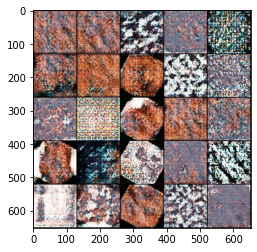

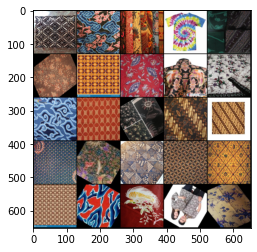

Epoch: 19: Step 1540: Generator loss 28.436436789376394, Critic loss -10.655450853620257


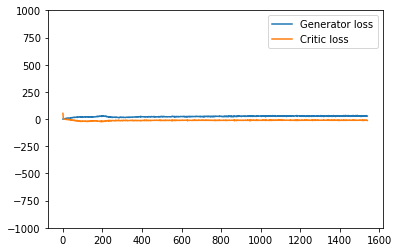

saving checkpoint 1541 35
saving checkpoint 1542 35
saving checkpoint 1543 35
saving checkpoint 1544 35
saving checkpoint 1545 35
saving checkpoint 1546 35
saving checkpoint 1547 35
saving checkpoint 1548 35
saving checkpoint 1549 35
saving checkpoint 1550 35
saving checkpoint 1551 35
saving checkpoint 1552 35
saving checkpoint 1553 35
saving checkpoint 1554 35
saving checkpoint 1555 35
saving checkpoint 1556 35
saving checkpoint 1557 35
saving checkpoint 1558 35
saving checkpoint 1559 35
saving checkpoint 1560 35
saving checkpoint 1561 35
saving checkpoint 1562 35
saving checkpoint 1563 35
saving checkpoint 1564 35
saving checkpoint 1565 35
saving checkpoint 1566 35
saving checkpoint 1567 35
saving checkpoint 1568 35
saving checkpoint 1569 35
saving checkpoint 1570 35
saving checkpoint 1571 35
saving checkpoint 1572 35
saving checkpoint 1573 35
saving checkpoint 1574 35


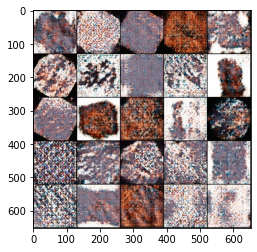

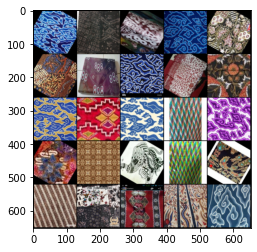

Epoch: 19: Step 1575: Generator loss 28.323500061035155, Critic loss -10.691989566258021


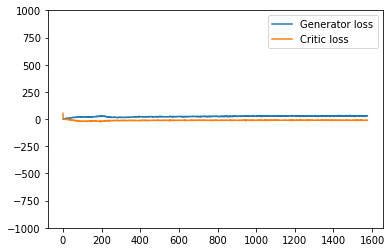

saving checkpoint 1576 35
saving checkpoint 1577 35
saving checkpoint 1578 35
saving checkpoint 1579 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1580 35
saving checkpoint 1581 35
saving checkpoint 1582 35
saving checkpoint 1583 35
saving checkpoint 1584 35
saving checkpoint 1585 35
saving checkpoint 1586 35
saving checkpoint 1587 35
saving checkpoint 1588 35
saving checkpoint 1589 35
saving checkpoint 1590 35
saving checkpoint 1591 35
saving checkpoint 1592 35
saving checkpoint 1593 35
saving checkpoint 1594 35
saving checkpoint 1595 35
saving checkpoint 1596 35
saving checkpoint 1597 35
saving checkpoint 1598 35
saving checkpoint 1599 35
saving checkpoint 1600 35
saving checkpoint 1601 35
saving checkpoint 1602 35
saving checkpoint 1603 35
saving checkpoint 1604 35
saving checkpoint 1605 35
saving checkpoint 1606 35
saving checkpoint 1607 35
saving checkpoint 1608 35
saving checkpoint 1609 35


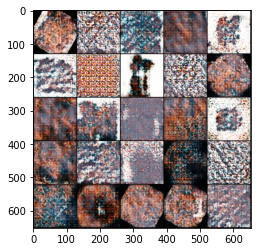

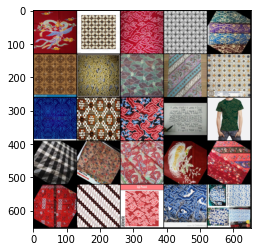

Epoch: 20: Step 1610: Generator loss 28.170330429077147, Critic loss -10.781740191323419


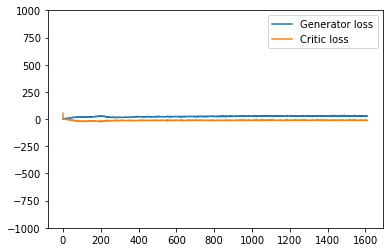

saving checkpoint 1611 35
saving checkpoint 1612 35
saving checkpoint 1613 35
saving checkpoint 1614 35
saving checkpoint 1615 35
saving checkpoint 1616 35
saving checkpoint 1617 35
saving checkpoint 1618 35
saving checkpoint 1619 35
saving checkpoint 1620 35
saving checkpoint 1621 35
saving checkpoint 1622 35
saving checkpoint 1623 35
saving checkpoint 1624 35
saving checkpoint 1625 35
saving checkpoint 1626 35
saving checkpoint 1627 35
saving checkpoint 1628 35
saving checkpoint 1629 35
saving checkpoint 1630 35
saving checkpoint 1631 35
saving checkpoint 1632 35
saving checkpoint 1633 35
saving checkpoint 1634 35
saving checkpoint 1635 35
saving checkpoint 1636 35
saving checkpoint 1637 35
saving checkpoint 1638 35
saving checkpoint 1639 35
saving checkpoint 1640 35
saving checkpoint 1641 35
saving checkpoint 1642 35
saving checkpoint 1643 35
saving checkpoint 1644 35


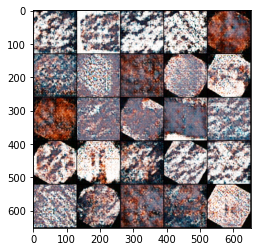

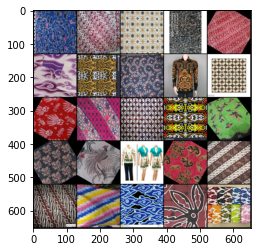

Epoch: 20: Step 1645: Generator loss 28.680012948172433, Critic loss -10.526175158364433


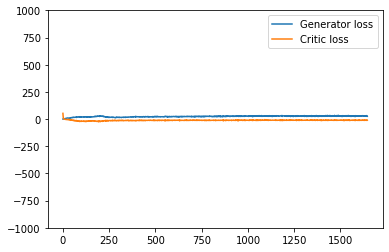

saving checkpoint 1646 35
saving checkpoint 1647 35
saving checkpoint 1648 35
saving checkpoint 1649 35
saving checkpoint 1650 35
saving checkpoint 1651 35
saving checkpoint 1652 35
saving checkpoint 1653 35
saving checkpoint 1654 35
saving checkpoint 1655 35
saving checkpoint 1656 35
saving checkpoint 1657 35
saving checkpoint 1658 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1659 35
saving checkpoint 1660 35
saving checkpoint 1661 35
saving checkpoint 1662 35
saving checkpoint 1663 35
saving checkpoint 1664 35
saving checkpoint 1665 35
saving checkpoint 1666 35
saving checkpoint 1667 35
saving checkpoint 1668 35
saving checkpoint 1669 35
saving checkpoint 1670 35
saving checkpoint 1671 35
saving checkpoint 1672 35
saving checkpoint 1673 35
saving checkpoint 1674 35
saving checkpoint 1675 35
saving checkpoint 1676 35
saving checkpoint 1677 35
saving checkpoint 1678 35
saving checkpoint 1679 35


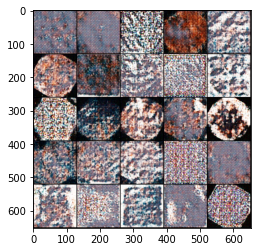

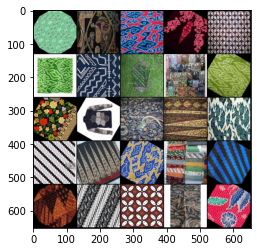

Epoch: 21: Step 1680: Generator loss 29.10923750741141, Critic loss -10.754643857138499


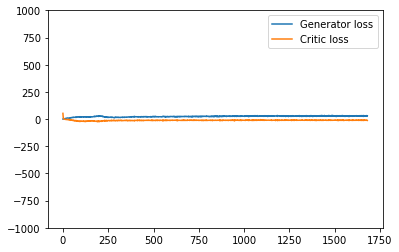

saving checkpoint 1681 35
saving checkpoint 1682 35
saving checkpoint 1683 35
saving checkpoint 1684 35
saving checkpoint 1685 35
saving checkpoint 1686 35
saving checkpoint 1687 35
saving checkpoint 1688 35
saving checkpoint 1689 35
saving checkpoint 1690 35
saving checkpoint 1691 35
saving checkpoint 1692 35
saving checkpoint 1693 35
saving checkpoint 1694 35
saving checkpoint 1695 35
saving checkpoint 1696 35
saving checkpoint 1697 35
saving checkpoint 1698 35
saving checkpoint 1699 35
saving checkpoint 1700 35
saving checkpoint 1701 35
saving checkpoint 1702 35
saving checkpoint 1703 35
saving checkpoint 1704 35
saving checkpoint 1705 35
saving checkpoint 1706 35
saving checkpoint 1707 35
saving checkpoint 1708 35
saving checkpoint 1709 35
saving checkpoint 1710 35
saving checkpoint 1711 35
saving checkpoint 1712 35
saving checkpoint 1713 35
saving checkpoint 1714 35


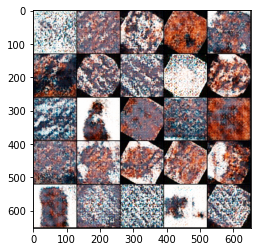

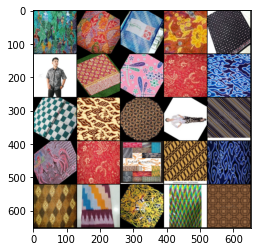

Epoch: 21: Step 1715: Generator loss 28.98481194632394, Critic loss -10.297399202074322


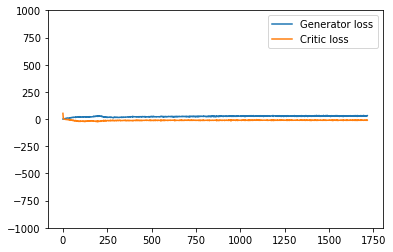

saving checkpoint 1716 35
saving checkpoint 1717 35
saving checkpoint 1718 35
saving checkpoint 1719 35
saving checkpoint 1720 35
saving checkpoint 1721 35
saving checkpoint 1722 35
saving checkpoint 1723 35
saving checkpoint 1724 35
saving checkpoint 1725 35
saving checkpoint 1726 35
saving checkpoint 1727 35
saving checkpoint 1728 35
saving checkpoint 1729 35
saving checkpoint 1730 35
saving checkpoint 1731 35
saving checkpoint 1732 35
saving checkpoint 1733 35
saving checkpoint 1734 35
saving checkpoint 1735 35
saving checkpoint 1736 35
saving checkpoint 1737 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1738 35
saving checkpoint 1739 35
saving checkpoint 1740 35
saving checkpoint 1741 35
saving checkpoint 1742 35
saving checkpoint 1743 35
saving checkpoint 1744 35
saving checkpoint 1745 35
saving checkpoint 1746 35
saving checkpoint 1747 35
saving checkpoint 1748 35
saving checkpoint 1749 35


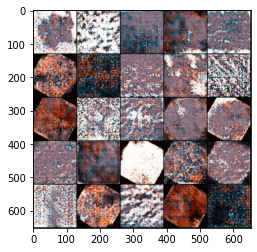

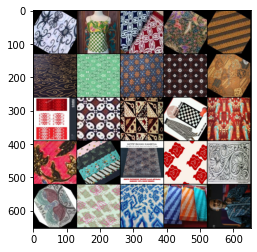

Epoch: 22: Step 1750: Generator loss 28.99969553266253, Critic loss -10.458483360835485


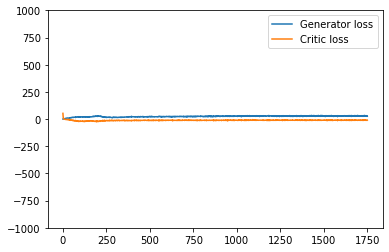

saving checkpoint 1751 35
saving checkpoint 1752 35
saving checkpoint 1753 35
saving checkpoint 1754 35
saving checkpoint 1755 35
saving checkpoint 1756 35
saving checkpoint 1757 35
saving checkpoint 1758 35
saving checkpoint 1759 35
saving checkpoint 1760 35
saving checkpoint 1761 35
saving checkpoint 1762 35
saving checkpoint 1763 35
saving checkpoint 1764 35
saving checkpoint 1765 35
saving checkpoint 1766 35
saving checkpoint 1767 35
saving checkpoint 1768 35
saving checkpoint 1769 35
saving checkpoint 1770 35
saving checkpoint 1771 35
saving checkpoint 1772 35
saving checkpoint 1773 35
saving checkpoint 1774 35
saving checkpoint 1775 35
saving checkpoint 1776 35
saving checkpoint 1777 35
saving checkpoint 1778 35
saving checkpoint 1779 35
saving checkpoint 1780 35
saving checkpoint 1781 35
saving checkpoint 1782 35
saving checkpoint 1783 35
saving checkpoint 1784 35


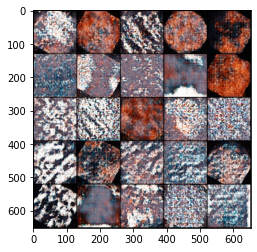

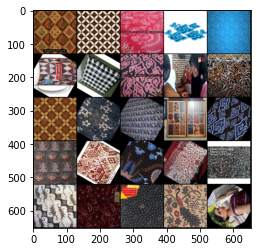

Epoch: 22: Step 1785: Generator loss 28.76329678126744, Critic loss -10.302841042109899


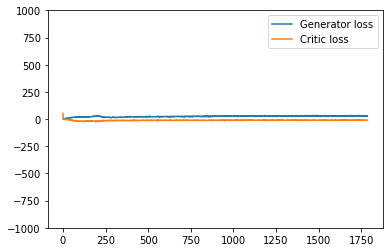

saving checkpoint 1786 35
saving checkpoint 1787 35
saving checkpoint 1788 35
saving checkpoint 1789 35
saving checkpoint 1790 35
saving checkpoint 1791 35
saving checkpoint 1792 35
saving checkpoint 1793 35
saving checkpoint 1794 35
saving checkpoint 1795 35
saving checkpoint 1796 35
saving checkpoint 1797 35
saving checkpoint 1798 35
saving checkpoint 1799 35
saving checkpoint 1800 35
saving checkpoint 1801 35
saving checkpoint 1802 35
saving checkpoint 1803 35
saving checkpoint 1804 35
saving checkpoint 1805 35
saving checkpoint 1806 35
saving checkpoint 1807 35
saving checkpoint 1808 35
saving checkpoint 1809 35
saving checkpoint 1810 35
saving checkpoint 1811 35
saving checkpoint 1812 35
saving checkpoint 1813 35
saving checkpoint 1814 35
saving checkpoint 1815 35
saving checkpoint 1816 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1817 35
saving checkpoint 1818 35
saving checkpoint 1819 35


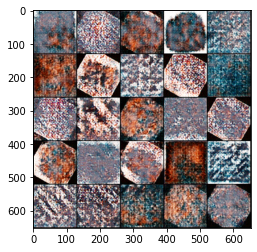

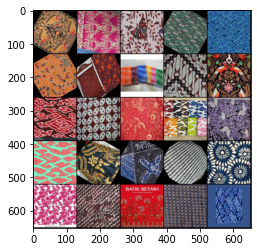

Epoch: 23: Step 1820: Generator loss 29.583523668561664, Critic loss -10.403065507071359


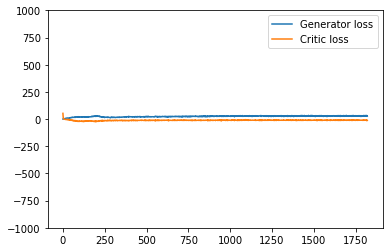

saving checkpoint 1821 35
saving checkpoint 1822 35
saving checkpoint 1823 35
saving checkpoint 1824 35
saving checkpoint 1825 35
saving checkpoint 1826 35
saving checkpoint 1827 35
saving checkpoint 1828 35
saving checkpoint 1829 35
saving checkpoint 1830 35
saving checkpoint 1831 35
saving checkpoint 1832 35
saving checkpoint 1833 35
saving checkpoint 1834 35
saving checkpoint 1835 35
saving checkpoint 1836 35
saving checkpoint 1837 35
saving checkpoint 1838 35
saving checkpoint 1839 35
saving checkpoint 1840 35
saving checkpoint 1841 35
saving checkpoint 1842 35
saving checkpoint 1843 35
saving checkpoint 1844 35
saving checkpoint 1845 35
saving checkpoint 1846 35
saving checkpoint 1847 35
saving checkpoint 1848 35
saving checkpoint 1849 35
saving checkpoint 1850 35
saving checkpoint 1851 35
saving checkpoint 1852 35
saving checkpoint 1853 35
saving checkpoint 1854 35


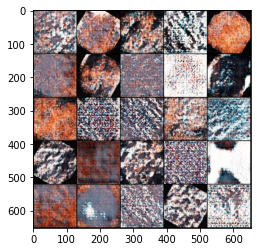

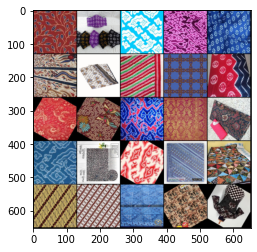

Epoch: 23: Step 1855: Generator loss 29.897688838413785, Critic loss -10.662677301679338


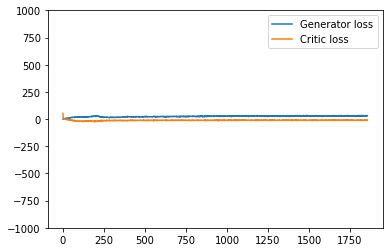

saving checkpoint 1856 35
saving checkpoint 1857 35
saving checkpoint 1858 35
saving checkpoint 1859 35
saving checkpoint 1860 35
saving checkpoint 1861 35
saving checkpoint 1862 35
saving checkpoint 1863 35
saving checkpoint 1864 35
saving checkpoint 1865 35
saving checkpoint 1866 35
saving checkpoint 1867 35
saving checkpoint 1868 35
saving checkpoint 1869 35
saving checkpoint 1870 35
saving checkpoint 1871 35
saving checkpoint 1872 35
saving checkpoint 1873 35
saving checkpoint 1874 35
saving checkpoint 1875 35
saving checkpoint 1876 35
saving checkpoint 1877 35
saving checkpoint 1878 35
saving checkpoint 1879 35
saving checkpoint 1880 35
saving checkpoint 1881 35
saving checkpoint 1882 35
saving checkpoint 1883 35
saving checkpoint 1884 35
saving checkpoint 1885 35
saving checkpoint 1886 35
saving checkpoint 1887 35
saving checkpoint 1888 35
saving checkpoint 1889 35


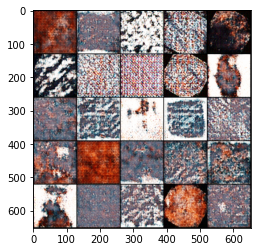

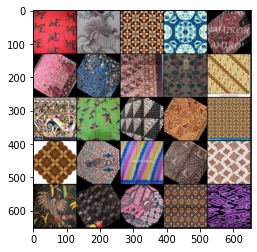

Epoch: 23: Step 1890: Generator loss 30.566296223231724, Critic loss -10.314454541887557


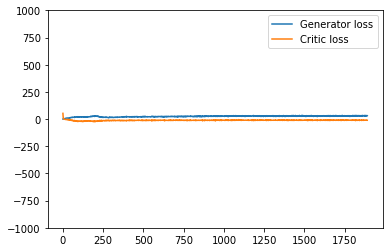

saving checkpoint 1891 35
saving checkpoint 1892 35
saving checkpoint 1893 35
saving checkpoint 1894 35
saving checkpoint 1895 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1896 35
saving checkpoint 1897 35
saving checkpoint 1898 35
saving checkpoint 1899 35
saving checkpoint 1900 35
saving checkpoint 1901 35
saving checkpoint 1902 35
saving checkpoint 1903 35
saving checkpoint 1904 35
saving checkpoint 1905 35
saving checkpoint 1906 35
saving checkpoint 1907 35
saving checkpoint 1908 35
saving checkpoint 1909 35
saving checkpoint 1910 35
saving checkpoint 1911 35
saving checkpoint 1912 35
saving checkpoint 1913 35
saving checkpoint 1914 35
saving checkpoint 1915 35
saving checkpoint 1916 35
saving checkpoint 1917 35
saving checkpoint 1918 35
saving checkpoint 1919 35
saving checkpoint 1920 35
saving checkpoint 1921 35
saving checkpoint 1922 35
saving checkpoint 1923 35
saving checkpoint 1924 35


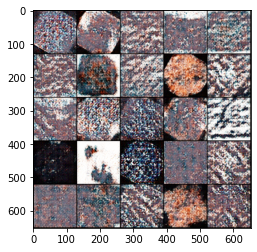

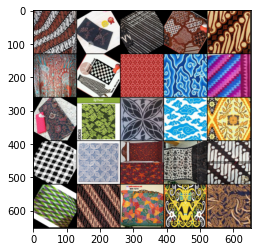

Epoch: 24: Step 1925: Generator loss 29.807050922938757, Critic loss -10.22185402188982


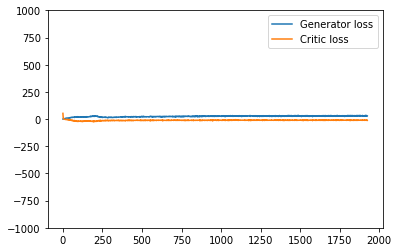

saving checkpoint 1926 35
saving checkpoint 1927 35
saving checkpoint 1928 35
saving checkpoint 1929 35
saving checkpoint 1930 35
saving checkpoint 1931 35
saving checkpoint 1932 35
saving checkpoint 1933 35
saving checkpoint 1934 35
saving checkpoint 1935 35
saving checkpoint 1936 35
saving checkpoint 1937 35
saving checkpoint 1938 35
saving checkpoint 1939 35
saving checkpoint 1940 35
saving checkpoint 1941 35
saving checkpoint 1942 35
saving checkpoint 1943 35
saving checkpoint 1944 35
saving checkpoint 1945 35
saving checkpoint 1946 35
saving checkpoint 1947 35
saving checkpoint 1948 35
saving checkpoint 1949 35
saving checkpoint 1950 35
saving checkpoint 1951 35
saving checkpoint 1952 35
saving checkpoint 1953 35
saving checkpoint 1954 35
saving checkpoint 1955 35
saving checkpoint 1956 35
saving checkpoint 1957 35
saving checkpoint 1958 35
saving checkpoint 1959 35


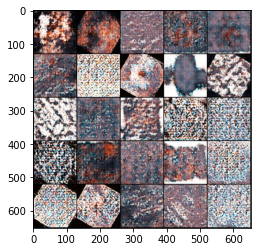

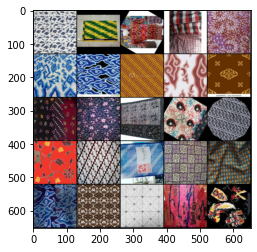

Epoch: 24: Step 1960: Generator loss 30.279057039533342, Critic loss -10.40776490347726


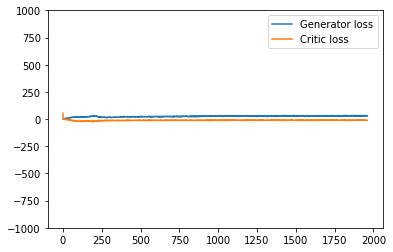

saving checkpoint 1961 35
saving checkpoint 1962 35
saving checkpoint 1963 35
saving checkpoint 1964 35
saving checkpoint 1965 35
saving checkpoint 1966 35
saving checkpoint 1967 35
saving checkpoint 1968 35
saving checkpoint 1969 35
saving checkpoint 1970 35
saving checkpoint 1971 35
saving checkpoint 1972 35
saving checkpoint 1973 35
saving checkpoint 1974 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 1975 35
saving checkpoint 1976 35
saving checkpoint 1977 35
saving checkpoint 1978 35
saving checkpoint 1979 35
saving checkpoint 1980 35
saving checkpoint 1981 35
saving checkpoint 1982 35
saving checkpoint 1983 35
saving checkpoint 1984 35
saving checkpoint 1985 35
saving checkpoint 1986 35
saving checkpoint 1987 35
saving checkpoint 1988 35
saving checkpoint 1989 35
saving checkpoint 1990 35
saving checkpoint 1991 35
saving checkpoint 1992 35
saving checkpoint 1993 35
saving checkpoint 1994 35


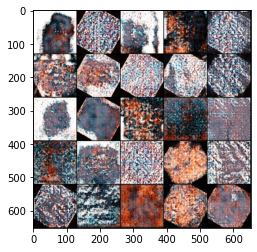

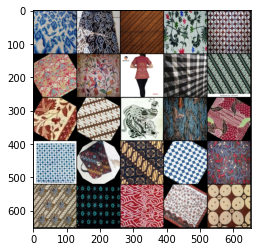

Epoch: 25: Step 1995: Generator loss 30.527590887887136, Critic loss -10.533637717110768


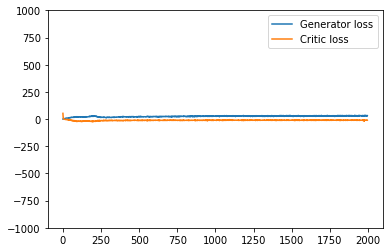

saving checkpoint 1996 35
saving checkpoint 1997 35
saving checkpoint 1998 35
saving checkpoint 1999 35
saving checkpoint 2000 35
saving checkpoint 2001 35
saving checkpoint 2002 35
saving checkpoint 2003 35
saving checkpoint 2004 35
saving checkpoint 2005 35
saving checkpoint 2006 35
saving checkpoint 2007 35
saving checkpoint 2008 35
saving checkpoint 2009 35
saving checkpoint 2010 35
saving checkpoint 2011 35
saving checkpoint 2012 35
saving checkpoint 2013 35
saving checkpoint 2014 35
saving checkpoint 2015 35
saving checkpoint 2016 35
saving checkpoint 2017 35
saving checkpoint 2018 35
saving checkpoint 2019 35
saving checkpoint 2020 35
saving checkpoint 2021 35
saving checkpoint 2022 35
saving checkpoint 2023 35
saving checkpoint 2024 35
saving checkpoint 2025 35
saving checkpoint 2026 35
saving checkpoint 2027 35
saving checkpoint 2028 35
saving checkpoint 2029 35


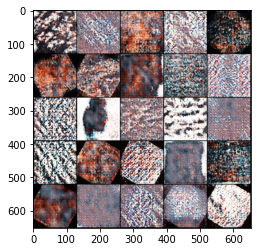

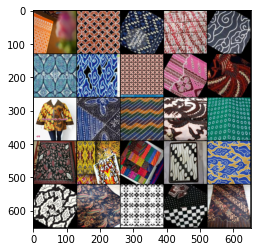

Epoch: 25: Step 2030: Generator loss 31.330552564348494, Critic loss -10.294472631726947


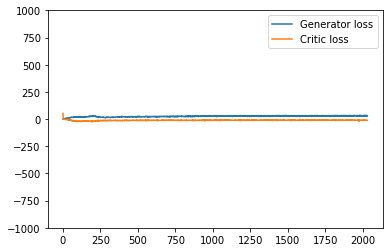

saving checkpoint 2031 35
saving checkpoint 2032 35
saving checkpoint 2033 35
saving checkpoint 2034 35
saving checkpoint 2035 35
saving checkpoint 2036 35
saving checkpoint 2037 35
saving checkpoint 2038 35
saving checkpoint 2039 35
saving checkpoint 2040 35
saving checkpoint 2041 35
saving checkpoint 2042 35
saving checkpoint 2043 35
saving checkpoint 2044 35
saving checkpoint 2045 35
saving checkpoint 2046 35
saving checkpoint 2047 35
saving checkpoint 2048 35
saving checkpoint 2049 35
saving checkpoint 2050 35
saving checkpoint 2051 35
saving checkpoint 2052 35
saving checkpoint 2053 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2054 35
saving checkpoint 2055 35
saving checkpoint 2056 35
saving checkpoint 2057 35
saving checkpoint 2058 35
saving checkpoint 2059 35
saving checkpoint 2060 35
saving checkpoint 2061 35
saving checkpoint 2062 35
saving checkpoint 2063 35
saving checkpoint 2064 35


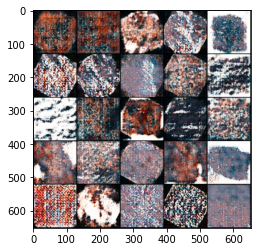

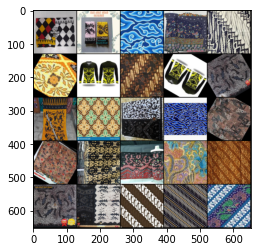

Epoch: 26: Step 2065: Generator loss 30.015278353009904, Critic loss -10.278826773507253


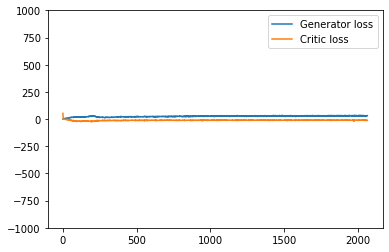

saving checkpoint 2066 35
saving checkpoint 2067 35
saving checkpoint 2068 35
saving checkpoint 2069 35
saving checkpoint 2070 35
saving checkpoint 2071 35
saving checkpoint 2072 35
saving checkpoint 2073 35
saving checkpoint 2074 35
saving checkpoint 2075 35
saving checkpoint 2076 35
saving checkpoint 2077 35
saving checkpoint 2078 35
saving checkpoint 2079 35
saving checkpoint 2080 35
saving checkpoint 2081 35
saving checkpoint 2082 35
saving checkpoint 2083 35
saving checkpoint 2084 35
saving checkpoint 2085 35
saving checkpoint 2086 35
saving checkpoint 2087 35
saving checkpoint 2088 35
saving checkpoint 2089 35
saving checkpoint 2090 35
saving checkpoint 2091 35
saving checkpoint 2092 35
saving checkpoint 2093 35
saving checkpoint 2094 35
saving checkpoint 2095 35
saving checkpoint 2096 35
saving checkpoint 2097 35
saving checkpoint 2098 35
saving checkpoint 2099 35


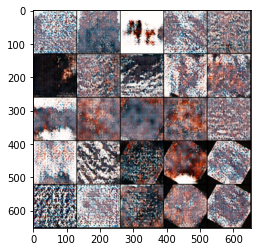

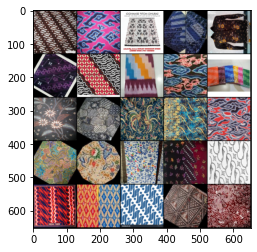

Epoch: 26: Step 2100: Generator loss 30.546206392560688, Critic loss -10.006365495409282


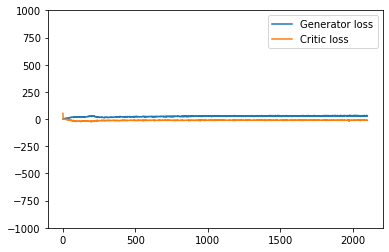

saving checkpoint 2101 35
saving checkpoint 2102 35
saving checkpoint 2103 35
saving checkpoint 2104 35
saving checkpoint 2105 35
saving checkpoint 2106 35
saving checkpoint 2107 35
saving checkpoint 2108 35
saving checkpoint 2109 35
saving checkpoint 2110 35
saving checkpoint 2111 35
saving checkpoint 2112 35
saving checkpoint 2113 35
saving checkpoint 2114 35
saving checkpoint 2115 35
saving checkpoint 2116 35
saving checkpoint 2117 35
saving checkpoint 2118 35
saving checkpoint 2119 35
saving checkpoint 2120 35
saving checkpoint 2121 35
saving checkpoint 2122 35
saving checkpoint 2123 35
saving checkpoint 2124 35
saving checkpoint 2125 35
saving checkpoint 2126 35
saving checkpoint 2127 35
saving checkpoint 2128 35
saving checkpoint 2129 35
saving checkpoint 2130 35
saving checkpoint 2131 35
saving checkpoint 2132 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2133 35
saving checkpoint 2134 35


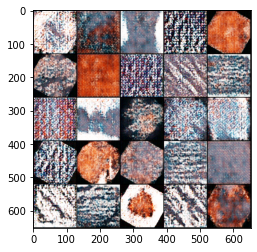

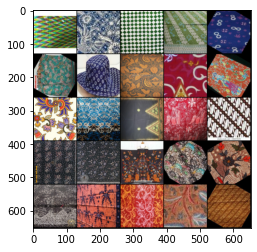

Epoch: 27: Step 2135: Generator loss 31.40026773725237, Critic loss -10.413667866843083


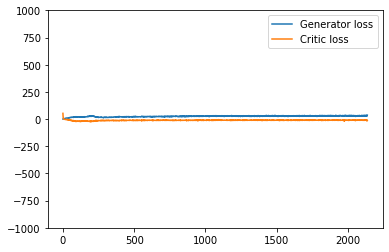

saving checkpoint 2136 35
saving checkpoint 2137 35
saving checkpoint 2138 35
saving checkpoint 2139 35
saving checkpoint 2140 35
saving checkpoint 2141 35
saving checkpoint 2142 35
saving checkpoint 2143 35
saving checkpoint 2144 35
saving checkpoint 2145 35
saving checkpoint 2146 35
saving checkpoint 2147 35
saving checkpoint 2148 35
saving checkpoint 2149 35
saving checkpoint 2150 35
saving checkpoint 2151 35
saving checkpoint 2152 35
saving checkpoint 2153 35
saving checkpoint 2154 35
saving checkpoint 2155 35
saving checkpoint 2156 35
saving checkpoint 2157 35
saving checkpoint 2158 35
saving checkpoint 2159 35
saving checkpoint 2160 35
saving checkpoint 2161 35
saving checkpoint 2162 35
saving checkpoint 2163 35
saving checkpoint 2164 35
saving checkpoint 2165 35
saving checkpoint 2166 35
saving checkpoint 2167 35
saving checkpoint 2168 35
saving checkpoint 2169 35


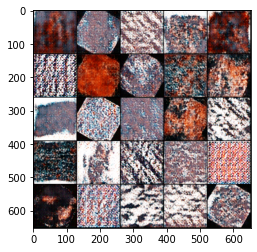

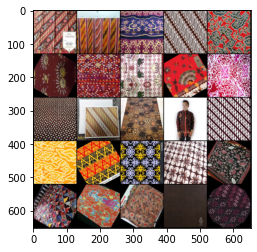

Epoch: 27: Step 2170: Generator loss 30.853160858154297, Critic loss -9.928573186056955


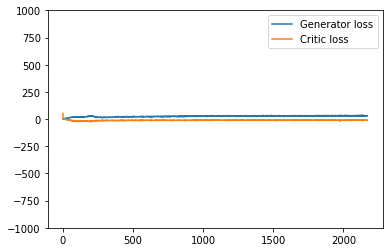

saving checkpoint 2171 35
saving checkpoint 2172 35
saving checkpoint 2173 35
saving checkpoint 2174 35
saving checkpoint 2175 35
saving checkpoint 2176 35
saving checkpoint 2177 35
saving checkpoint 2178 35
saving checkpoint 2179 35
saving checkpoint 2180 35
saving checkpoint 2181 35
saving checkpoint 2182 35
saving checkpoint 2183 35
saving checkpoint 2184 35
saving checkpoint 2185 35
saving checkpoint 2186 35
saving checkpoint 2187 35
saving checkpoint 2188 35
saving checkpoint 2189 35
saving checkpoint 2190 35
saving checkpoint 2191 35
saving checkpoint 2192 35
saving checkpoint 2193 35
saving checkpoint 2194 35
saving checkpoint 2195 35
saving checkpoint 2196 35
saving checkpoint 2197 35
saving checkpoint 2198 35
saving checkpoint 2199 35
saving checkpoint 2200 35
saving checkpoint 2201 35
saving checkpoint 2202 35
saving checkpoint 2203 35
saving checkpoint 2204 35


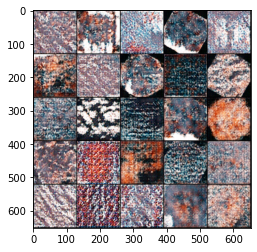

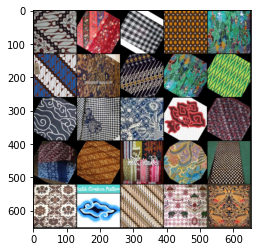

Epoch: 27: Step 2205: Generator loss 30.66734335763114, Critic loss -10.244189493996755


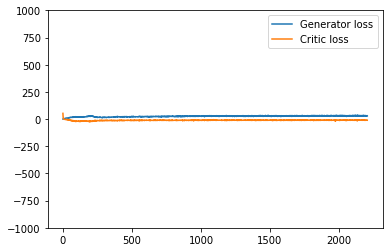

saving checkpoint 2206 35
saving checkpoint 2207 35
saving checkpoint 2208 35
saving checkpoint 2209 35
saving checkpoint 2210 35
saving checkpoint 2211 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2212 35
saving checkpoint 2213 35
saving checkpoint 2214 35
saving checkpoint 2215 35
saving checkpoint 2216 35
saving checkpoint 2217 35
saving checkpoint 2218 35
saving checkpoint 2219 35
saving checkpoint 2220 35
saving checkpoint 2221 35
saving checkpoint 2222 35
saving checkpoint 2223 35
saving checkpoint 2224 35
saving checkpoint 2225 35
saving checkpoint 2226 35
saving checkpoint 2227 35
saving checkpoint 2228 35
saving checkpoint 2229 35
saving checkpoint 2230 35
saving checkpoint 2231 35
saving checkpoint 2232 35
saving checkpoint 2233 35
saving checkpoint 2234 35
saving checkpoint 2235 35
saving checkpoint 2236 35
saving checkpoint 2237 35
saving checkpoint 2238 35
saving checkpoint 2239 35


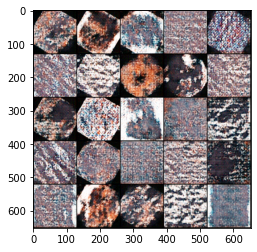

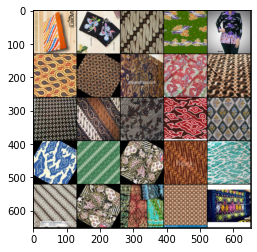

Epoch: 28: Step 2240: Generator loss 30.78194890703474, Critic loss -10.387441150120326


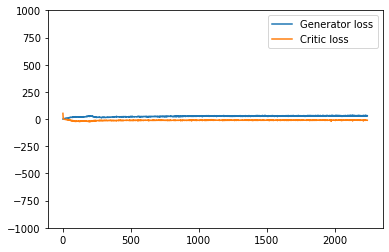

saving checkpoint 2241 35
saving checkpoint 2242 35
saving checkpoint 2243 35
saving checkpoint 2244 35
saving checkpoint 2245 35
saving checkpoint 2246 35
saving checkpoint 2247 35
saving checkpoint 2248 35
saving checkpoint 2249 35
saving checkpoint 2250 35
saving checkpoint 2251 35
saving checkpoint 2252 35
saving checkpoint 2253 35
saving checkpoint 2254 35
saving checkpoint 2255 35
saving checkpoint 2256 35
saving checkpoint 2257 35
saving checkpoint 2258 35
saving checkpoint 2259 35
saving checkpoint 2260 35
saving checkpoint 2261 35
saving checkpoint 2262 35
saving checkpoint 2263 35
saving checkpoint 2264 35
saving checkpoint 2265 35
saving checkpoint 2266 35
saving checkpoint 2267 35
saving checkpoint 2268 35
saving checkpoint 2269 35
saving checkpoint 2270 35
saving checkpoint 2271 35
saving checkpoint 2272 35
saving checkpoint 2273 35
saving checkpoint 2274 35


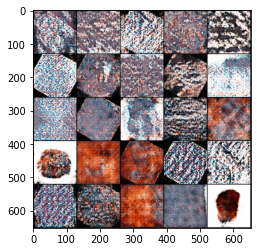

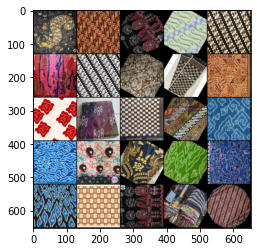

Epoch: 28: Step 2275: Generator loss 31.44746889386858, Critic loss -10.250214304242814


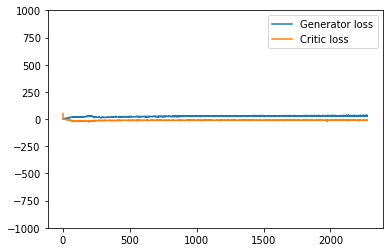

saving checkpoint 2276 35
saving checkpoint 2277 35
saving checkpoint 2278 35
saving checkpoint 2279 35
saving checkpoint 2280 35
saving checkpoint 2281 35
saving checkpoint 2282 35
saving checkpoint 2283 35
saving checkpoint 2284 35
saving checkpoint 2285 35
saving checkpoint 2286 35
saving checkpoint 2287 35
saving checkpoint 2288 35
saving checkpoint 2289 35
saving checkpoint 2290 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2291 35
saving checkpoint 2292 35
saving checkpoint 2293 35
saving checkpoint 2294 35
saving checkpoint 2295 35
saving checkpoint 2296 35
saving checkpoint 2297 35
saving checkpoint 2298 35
saving checkpoint 2299 35
saving checkpoint 2300 35
saving checkpoint 2301 35
saving checkpoint 2302 35
saving checkpoint 2303 35
saving checkpoint 2304 35
saving checkpoint 2305 35
saving checkpoint 2306 35
saving checkpoint 2307 35
saving checkpoint 2308 35
saving checkpoint 2309 35


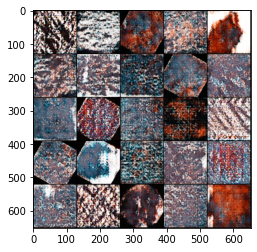

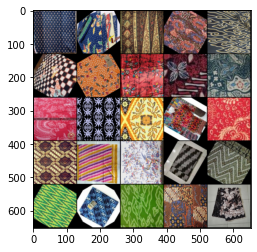

Epoch: 29: Step 2310: Generator loss 30.900014550345286, Critic loss -10.317780481066023


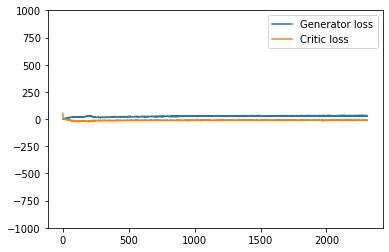

saving checkpoint 2311 35
saving checkpoint 2312 35
saving checkpoint 2313 35
saving checkpoint 2314 35
saving checkpoint 2315 35
saving checkpoint 2316 35
saving checkpoint 2317 35
saving checkpoint 2318 35
saving checkpoint 2319 35
saving checkpoint 2320 35
saving checkpoint 2321 35
saving checkpoint 2322 35
saving checkpoint 2323 35
saving checkpoint 2324 35
saving checkpoint 2325 35
saving checkpoint 2326 35
saving checkpoint 2327 35
saving checkpoint 2328 35
saving checkpoint 2329 35
saving checkpoint 2330 35
saving checkpoint 2331 35
saving checkpoint 2332 35
saving checkpoint 2333 35
saving checkpoint 2334 35
saving checkpoint 2335 35
saving checkpoint 2336 35
saving checkpoint 2337 35
saving checkpoint 2338 35
saving checkpoint 2339 35
saving checkpoint 2340 35
saving checkpoint 2341 35
saving checkpoint 2342 35
saving checkpoint 2343 35
saving checkpoint 2344 35


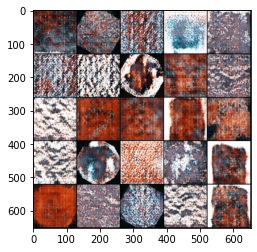

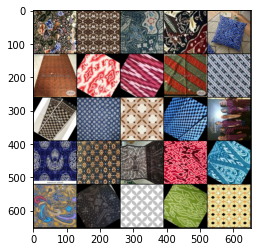

Epoch: 29: Step 2345: Generator loss 30.91710297720773, Critic loss -10.164482533591135


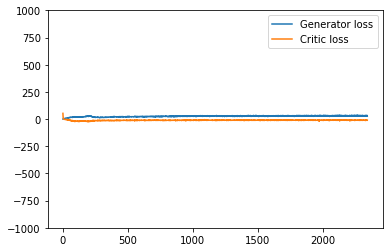

saving checkpoint 2346 35
saving checkpoint 2347 35
saving checkpoint 2348 35
saving checkpoint 2349 35
saving checkpoint 2350 35
saving checkpoint 2351 35
saving checkpoint 2352 35
saving checkpoint 2353 35
saving checkpoint 2354 35
saving checkpoint 2355 35
saving checkpoint 2356 35
saving checkpoint 2357 35
saving checkpoint 2358 35
saving checkpoint 2359 35
saving checkpoint 2360 35
saving checkpoint 2361 35
saving checkpoint 2362 35
saving checkpoint 2363 35
saving checkpoint 2364 35
saving checkpoint 2365 35
saving checkpoint 2366 35
saving checkpoint 2367 35
saving checkpoint 2368 35
saving checkpoint 2369 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2370 35
saving checkpoint 2371 35
saving checkpoint 2372 35
saving checkpoint 2373 35
saving checkpoint 2374 35
saving checkpoint 2375 35
saving checkpoint 2376 35
saving checkpoint 2377 35
saving checkpoint 2378 35
saving checkpoint 2379 35


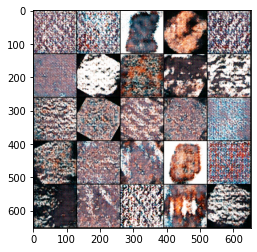

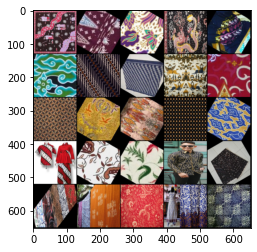

Epoch: 30: Step 2380: Generator loss 31.462700980050222, Critic loss -10.21488804953439


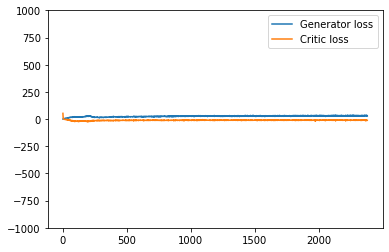

saving checkpoint 2381 35
saving checkpoint 2382 35
saving checkpoint 2383 35
saving checkpoint 2384 35
saving checkpoint 2385 35
saving checkpoint 2386 35
saving checkpoint 2387 35
saving checkpoint 2388 35
saving checkpoint 2389 35
saving checkpoint 2390 35
saving checkpoint 2391 35
saving checkpoint 2392 35
saving checkpoint 2393 35
saving checkpoint 2394 35
saving checkpoint 2395 35
saving checkpoint 2396 35
saving checkpoint 2397 35
saving checkpoint 2398 35
saving checkpoint 2399 35
saving checkpoint 2400 35
saving checkpoint 2401 35
saving checkpoint 2402 35
saving checkpoint 2403 35
saving checkpoint 2404 35
saving checkpoint 2405 35
saving checkpoint 2406 35
saving checkpoint 2407 35
saving checkpoint 2408 35
saving checkpoint 2409 35
saving checkpoint 2410 35
saving checkpoint 2411 35
saving checkpoint 2412 35
saving checkpoint 2413 35
saving checkpoint 2414 35


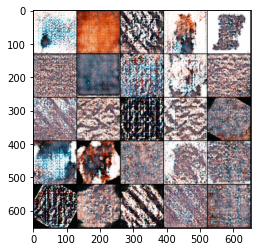

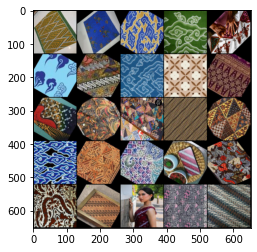

Epoch: 30: Step 2415: Generator loss 31.31251629420689, Critic loss -10.335151724134175


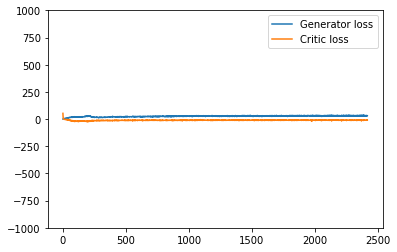

saving checkpoint 2416 35
saving checkpoint 2417 35
saving checkpoint 2418 35
saving checkpoint 2419 35
saving checkpoint 2420 35
saving checkpoint 2421 35
saving checkpoint 2422 35
saving checkpoint 2423 35
saving checkpoint 2424 35
saving checkpoint 2425 35
saving checkpoint 2426 35
saving checkpoint 2427 35
saving checkpoint 2428 35
saving checkpoint 2429 35
saving checkpoint 2430 35
saving checkpoint 2431 35
saving checkpoint 2432 35
saving checkpoint 2433 35
saving checkpoint 2434 35
saving checkpoint 2435 35
saving checkpoint 2436 35
saving checkpoint 2437 35
saving checkpoint 2438 35
saving checkpoint 2439 35
saving checkpoint 2440 35
saving checkpoint 2441 35
saving checkpoint 2442 35
saving checkpoint 2443 35
saving checkpoint 2444 35
saving checkpoint 2445 35
saving checkpoint 2446 35
saving checkpoint 2447 35
saving checkpoint 2448 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2449 35


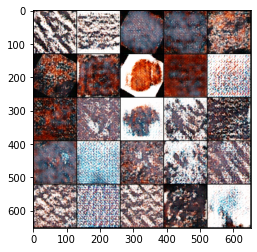

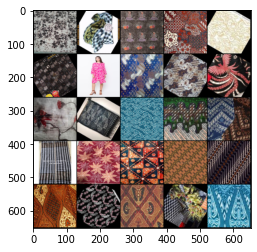

Epoch: 31: Step 2450: Generator loss 31.06380353655134, Critic loss -10.21164320537022


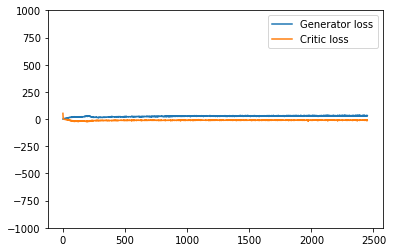

saving checkpoint 2451 35
saving checkpoint 2452 35
saving checkpoint 2453 35
saving checkpoint 2454 35
saving checkpoint 2455 35
saving checkpoint 2456 35
saving checkpoint 2457 35
saving checkpoint 2458 35
saving checkpoint 2459 35
saving checkpoint 2460 35
saving checkpoint 2461 35
saving checkpoint 2462 35
saving checkpoint 2463 35
saving checkpoint 2464 35
saving checkpoint 2465 35
saving checkpoint 2466 35
saving checkpoint 2467 35
saving checkpoint 2468 35
saving checkpoint 2469 35
saving checkpoint 2470 35
saving checkpoint 2471 35
saving checkpoint 2472 35
saving checkpoint 2473 35
saving checkpoint 2474 35
saving checkpoint 2475 35
saving checkpoint 2476 35
saving checkpoint 2477 35
saving checkpoint 2478 35
saving checkpoint 2479 35
saving checkpoint 2480 35
saving checkpoint 2481 35
saving checkpoint 2482 35
saving checkpoint 2483 35
saving checkpoint 2484 35


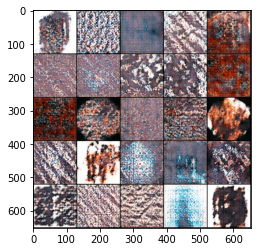

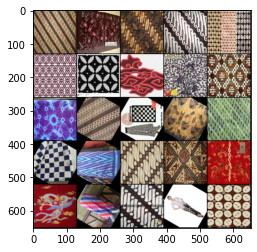

Epoch: 31: Step 2485: Generator loss 30.782718876429968, Critic loss -10.226239313398088


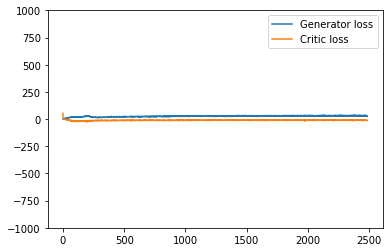

saving checkpoint 2486 35
saving checkpoint 2487 35
saving checkpoint 2488 35
saving checkpoint 2489 35
saving checkpoint 2490 35
saving checkpoint 2491 35
saving checkpoint 2492 35
saving checkpoint 2493 35
saving checkpoint 2494 35
saving checkpoint 2495 35
saving checkpoint 2496 35
saving checkpoint 2497 35
saving checkpoint 2498 35
saving checkpoint 2499 35
saving checkpoint 2500 35
saving checkpoint 2501 35
saving checkpoint 2502 35
saving checkpoint 2503 35
saving checkpoint 2504 35
saving checkpoint 2505 35
saving checkpoint 2506 35
saving checkpoint 2507 35
saving checkpoint 2508 35
saving checkpoint 2509 35
saving checkpoint 2510 35
saving checkpoint 2511 35
saving checkpoint 2512 35
saving checkpoint 2513 35
saving checkpoint 2514 35
saving checkpoint 2515 35
saving checkpoint 2516 35
saving checkpoint 2517 35
saving checkpoint 2518 35
saving checkpoint 2519 35


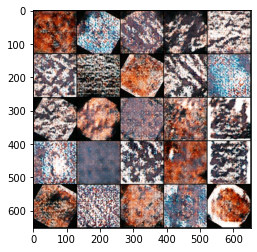

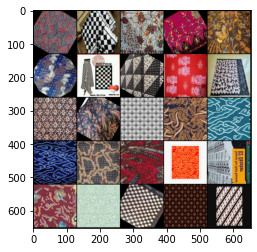

Epoch: 31: Step 2520: Generator loss 31.214240537370955, Critic loss -10.130416297912596


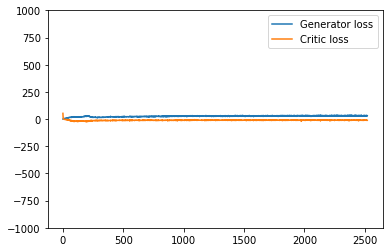

saving checkpoint 2521 35
saving checkpoint 2522 35
saving checkpoint 2523 35
saving checkpoint 2524 35
saving checkpoint 2525 35
saving checkpoint 2526 35
saving checkpoint 2527 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2528 35
saving checkpoint 2529 35
saving checkpoint 2530 35
saving checkpoint 2531 35
saving checkpoint 2532 35
saving checkpoint 2533 35
saving checkpoint 2534 35
saving checkpoint 2535 35
saving checkpoint 2536 35
saving checkpoint 2537 35
saving checkpoint 2538 35
saving checkpoint 2539 35
saving checkpoint 2540 35
saving checkpoint 2541 35
saving checkpoint 2542 35
saving checkpoint 2543 35
saving checkpoint 2544 35
saving checkpoint 2545 35
saving checkpoint 2546 35
saving checkpoint 2547 35
saving checkpoint 2548 35
saving checkpoint 2549 35
saving checkpoint 2550 35
saving checkpoint 2551 35
saving checkpoint 2552 35
saving checkpoint 2553 35
saving checkpoint 2554 35


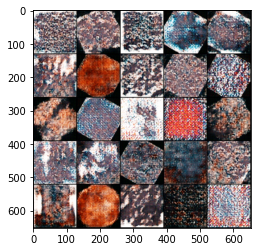

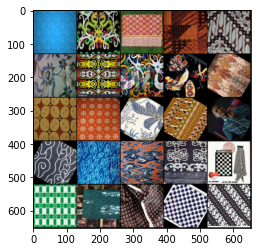

Epoch: 32: Step 2555: Generator loss 31.694973482404436, Critic loss -10.066337435586114


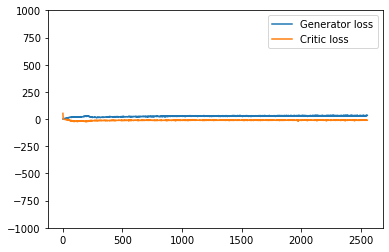

saving checkpoint 2556 35
saving checkpoint 2557 35
saving checkpoint 2558 35
saving checkpoint 2559 35
saving checkpoint 2560 35
saving checkpoint 2561 35
saving checkpoint 2562 35
saving checkpoint 2563 35
saving checkpoint 2564 35
saving checkpoint 2565 35
saving checkpoint 2566 35
saving checkpoint 2567 35
saving checkpoint 2568 35
saving checkpoint 2569 35
saving checkpoint 2570 35
saving checkpoint 2571 35
saving checkpoint 2572 35
saving checkpoint 2573 35
saving checkpoint 2574 35
saving checkpoint 2575 35
saving checkpoint 2576 35
saving checkpoint 2577 35
saving checkpoint 2578 35
saving checkpoint 2579 35
saving checkpoint 2580 35
saving checkpoint 2581 35
saving checkpoint 2582 35
saving checkpoint 2583 35
saving checkpoint 2584 35
saving checkpoint 2585 35
saving checkpoint 2586 35
saving checkpoint 2587 35
saving checkpoint 2588 35
saving checkpoint 2589 35


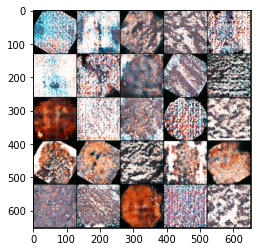

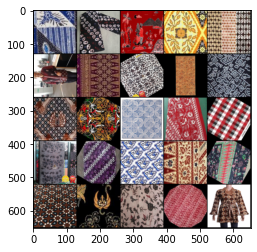

Epoch: 32: Step 2590: Generator loss 31.5631224496024, Critic loss -9.95669939586094


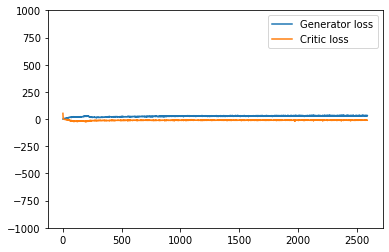

saving checkpoint 2591 35
saving checkpoint 2592 35
saving checkpoint 2593 35
saving checkpoint 2594 35
saving checkpoint 2595 35
saving checkpoint 2596 35
saving checkpoint 2597 35
saving checkpoint 2598 35
saving checkpoint 2599 35
saving checkpoint 2600 35
saving checkpoint 2601 35
saving checkpoint 2602 35
saving checkpoint 2603 35
saving checkpoint 2604 35
saving checkpoint 2605 35
saving checkpoint 2606 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2607 35
saving checkpoint 2608 35
saving checkpoint 2609 35
saving checkpoint 2610 35
saving checkpoint 2611 35
saving checkpoint 2612 35
saving checkpoint 2613 35
saving checkpoint 2614 35
saving checkpoint 2615 35
saving checkpoint 2616 35
saving checkpoint 2617 35
saving checkpoint 2618 35
saving checkpoint 2619 35
saving checkpoint 2620 35
saving checkpoint 2621 35
saving checkpoint 2622 35
saving checkpoint 2623 35
saving checkpoint 2624 35


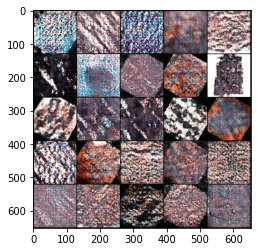

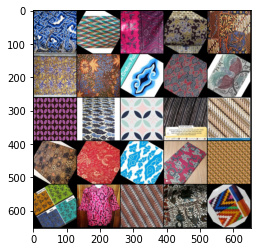

Epoch: 33: Step 2625: Generator loss 32.61506958007813, Critic loss -10.3861204120091


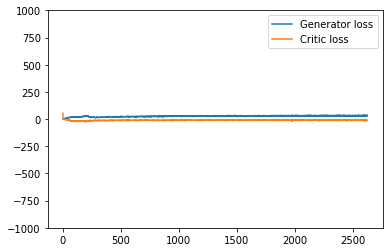

saving checkpoint 2626 35
saving checkpoint 2627 35
saving checkpoint 2628 35
saving checkpoint 2629 35
saving checkpoint 2630 35
saving checkpoint 2631 35
saving checkpoint 2632 35
saving checkpoint 2633 35
saving checkpoint 2634 35
saving checkpoint 2635 35
saving checkpoint 2636 35
saving checkpoint 2637 35
saving checkpoint 2638 35
saving checkpoint 2639 35
saving checkpoint 2640 35
saving checkpoint 2641 35
saving checkpoint 2642 35
saving checkpoint 2643 35
saving checkpoint 2644 35
saving checkpoint 2645 35
saving checkpoint 2646 35
saving checkpoint 2647 35
saving checkpoint 2648 35
saving checkpoint 2649 35
saving checkpoint 2650 35
saving checkpoint 2651 35
saving checkpoint 2652 35
saving checkpoint 2653 35
saving checkpoint 2654 35
saving checkpoint 2655 35
saving checkpoint 2656 35
saving checkpoint 2657 35
saving checkpoint 2658 35
saving checkpoint 2659 35


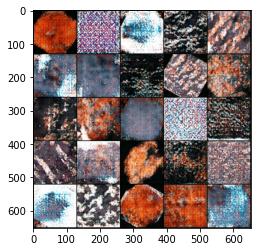

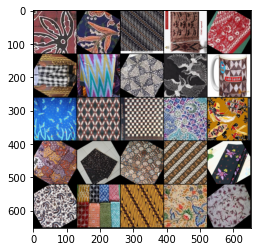

Epoch: 33: Step 2660: Generator loss 32.15608694893973, Critic loss -10.155467703683035


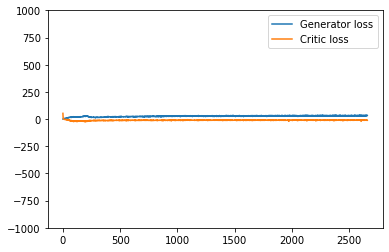

saving checkpoint 2661 35
saving checkpoint 2662 35
saving checkpoint 2663 35
saving checkpoint 2664 35
saving checkpoint 2665 35
saving checkpoint 2666 35
saving checkpoint 2667 35
saving checkpoint 2668 35
saving checkpoint 2669 35
saving checkpoint 2670 35
saving checkpoint 2671 35
saving checkpoint 2672 35
saving checkpoint 2673 35
saving checkpoint 2674 35
saving checkpoint 2675 35
saving checkpoint 2676 35
saving checkpoint 2677 35
saving checkpoint 2678 35
saving checkpoint 2679 35
saving checkpoint 2680 35
saving checkpoint 2681 35
saving checkpoint 2682 35
saving checkpoint 2683 35
saving checkpoint 2684 35
saving checkpoint 2685 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2686 35
saving checkpoint 2687 35
saving checkpoint 2688 35
saving checkpoint 2689 35
saving checkpoint 2690 35
saving checkpoint 2691 35
saving checkpoint 2692 35
saving checkpoint 2693 35
saving checkpoint 2694 35


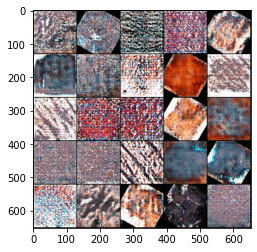

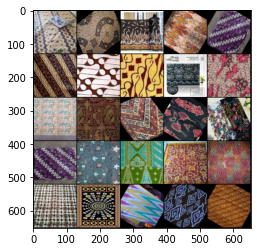

Epoch: 34: Step 2695: Generator loss 32.315430886404855, Critic loss -10.321217111860003


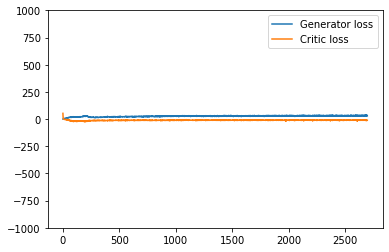

saving checkpoint 2696 35
saving checkpoint 2697 35
saving checkpoint 2698 35
saving checkpoint 2699 35
saving checkpoint 2700 35
saving checkpoint 2701 35
saving checkpoint 2702 35
saving checkpoint 2703 35
saving checkpoint 2704 35
saving checkpoint 2705 35
saving checkpoint 2706 35
saving checkpoint 2707 35
saving checkpoint 2708 35
saving checkpoint 2709 35
saving checkpoint 2710 35
saving checkpoint 2711 35
saving checkpoint 2712 35
saving checkpoint 2713 35
saving checkpoint 2714 35
saving checkpoint 2715 35
saving checkpoint 2716 35
saving checkpoint 2717 35
saving checkpoint 2718 35
saving checkpoint 2719 35
saving checkpoint 2720 35
saving checkpoint 2721 35
saving checkpoint 2722 35
saving checkpoint 2723 35
saving checkpoint 2724 35
saving checkpoint 2725 35
saving checkpoint 2726 35
saving checkpoint 2727 35
saving checkpoint 2728 35
saving checkpoint 2729 35


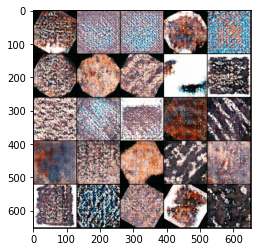

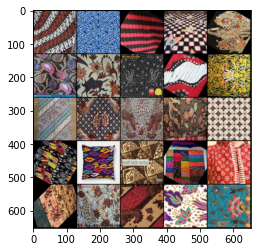

Epoch: 34: Step 2730: Generator loss 32.8251876286098, Critic loss -10.038797223227364


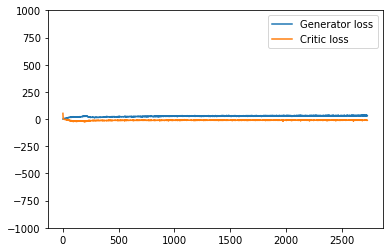

saving checkpoint 2731 35
saving checkpoint 2732 35
saving checkpoint 2733 35
saving checkpoint 2734 35
saving checkpoint 2735 35
saving checkpoint 2736 35
saving checkpoint 2737 35
saving checkpoint 2738 35
saving checkpoint 2739 35
saving checkpoint 2740 35
saving checkpoint 2741 35
saving checkpoint 2742 35
saving checkpoint 2743 35
saving checkpoint 2744 35
saving checkpoint 2745 35
saving checkpoint 2746 35
saving checkpoint 2747 35
saving checkpoint 2748 35
saving checkpoint 2749 35
saving checkpoint 2750 35
saving checkpoint 2751 35
saving checkpoint 2752 35
saving checkpoint 2753 35
saving checkpoint 2754 35
saving checkpoint 2755 35
saving checkpoint 2756 35
saving checkpoint 2757 35
saving checkpoint 2758 35
saving checkpoint 2759 35
saving checkpoint 2760 35
saving checkpoint 2761 35
saving checkpoint 2762 35
saving checkpoint 2763 35
saving checkpoint 2764 35


  0%|          | 0/79 [00:00<?, ?it/s]

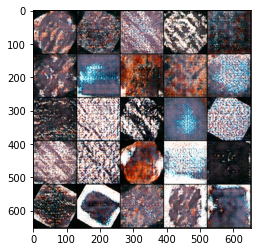

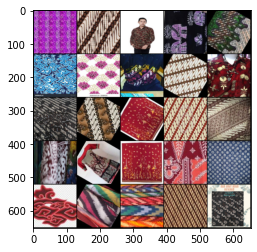

Epoch: 35: Step 2765: Generator loss 31.871637780325752, Critic loss -9.759488558088028


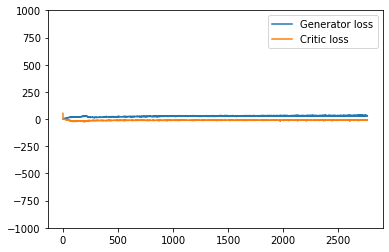

saving checkpoint 2766 35
saving checkpoint 2767 35
saving checkpoint 2768 35
saving checkpoint 2769 35
saving checkpoint 2770 35
saving checkpoint 2771 35
saving checkpoint 2772 35
saving checkpoint 2773 35
saving checkpoint 2774 35
saving checkpoint 2775 35
saving checkpoint 2776 35
saving checkpoint 2777 35
saving checkpoint 2778 35
saving checkpoint 2779 35
saving checkpoint 2780 35
saving checkpoint 2781 35
saving checkpoint 2782 35
saving checkpoint 2783 35
saving checkpoint 2784 35
saving checkpoint 2785 35
saving checkpoint 2786 35
saving checkpoint 2787 35
saving checkpoint 2788 35
saving checkpoint 2789 35
saving checkpoint 2790 35
saving checkpoint 2791 35
saving checkpoint 2792 35
saving checkpoint 2793 35
saving checkpoint 2794 35
saving checkpoint 2795 35
saving checkpoint 2796 35
saving checkpoint 2797 35
saving checkpoint 2798 35
saving checkpoint 2799 35


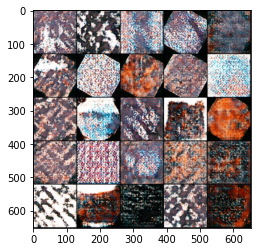

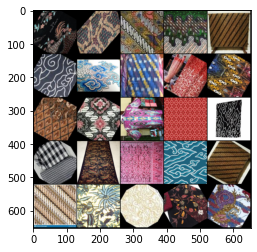

Epoch: 35: Step 2800: Generator loss 31.832991354806083, Critic loss -10.115881936209544


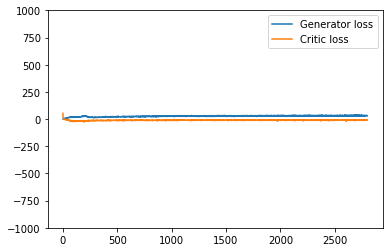

saving checkpoint 2801 35
saving checkpoint 2802 35
saving checkpoint 2803 35
saving checkpoint 2804 35
saving checkpoint 2805 35
saving checkpoint 2806 35
saving checkpoint 2807 35
saving checkpoint 2808 35
saving checkpoint 2809 35
saving checkpoint 2810 35
saving checkpoint 2811 35
saving checkpoint 2812 35
saving checkpoint 2813 35
saving checkpoint 2814 35
saving checkpoint 2815 35
saving checkpoint 2816 35
saving checkpoint 2817 35
saving checkpoint 2818 35
saving checkpoint 2819 35
saving checkpoint 2820 35
saving checkpoint 2821 35
saving checkpoint 2822 35
saving checkpoint 2823 35
saving checkpoint 2824 35
saving checkpoint 2825 35
saving checkpoint 2826 35
saving checkpoint 2827 35
saving checkpoint 2828 35
saving checkpoint 2829 35
saving checkpoint 2830 35
saving checkpoint 2831 35
saving checkpoint 2832 35
saving checkpoint 2833 35
saving checkpoint 2834 35


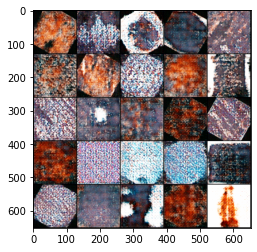

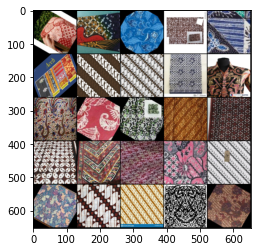

Epoch: 35: Step 2835: Generator loss 32.77481258937291, Critic loss -10.000867500305178


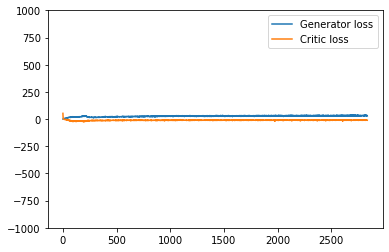

saving checkpoint 2836 35
saving checkpoint 2837 35
saving checkpoint 2838 35
saving checkpoint 2839 35
saving checkpoint 2840 35
saving checkpoint 2841 35
saving checkpoint 2842 35
saving checkpoint 2843 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2844 35
saving checkpoint 2845 35
saving checkpoint 2846 35
saving checkpoint 2847 35
saving checkpoint 2848 35
saving checkpoint 2849 35
saving checkpoint 2850 35
saving checkpoint 2851 35
saving checkpoint 2852 35
saving checkpoint 2853 35
saving checkpoint 2854 35
saving checkpoint 2855 35
saving checkpoint 2856 35
saving checkpoint 2857 35
saving checkpoint 2858 35
saving checkpoint 2859 35
saving checkpoint 2860 35
saving checkpoint 2861 35
saving checkpoint 2862 35
saving checkpoint 2863 35
saving checkpoint 2864 35
saving checkpoint 2865 35
saving checkpoint 2866 35
saving checkpoint 2867 35
saving checkpoint 2868 35
saving checkpoint 2869 35


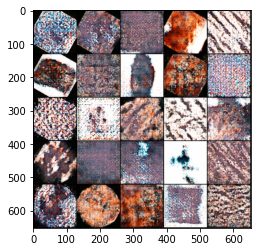

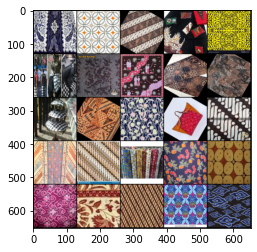

Epoch: 36: Step 2870: Generator loss 32.56298490251814, Critic loss -9.719185910906111


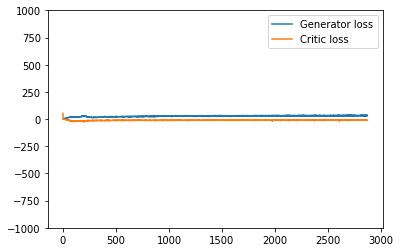

saving checkpoint 2871 35
saving checkpoint 2872 35
saving checkpoint 2873 35
saving checkpoint 2874 35
saving checkpoint 2875 35
saving checkpoint 2876 35
saving checkpoint 2877 35
saving checkpoint 2878 35
saving checkpoint 2879 35
saving checkpoint 2880 35
saving checkpoint 2881 35
saving checkpoint 2882 35
saving checkpoint 2883 35
saving checkpoint 2884 35
saving checkpoint 2885 35
saving checkpoint 2886 35
saving checkpoint 2887 35
saving checkpoint 2888 35
saving checkpoint 2889 35
saving checkpoint 2890 35
saving checkpoint 2891 35
saving checkpoint 2892 35
saving checkpoint 2893 35
saving checkpoint 2894 35
saving checkpoint 2895 35
saving checkpoint 2896 35
saving checkpoint 2897 35
saving checkpoint 2898 35
saving checkpoint 2899 35
saving checkpoint 2900 35
saving checkpoint 2901 35
saving checkpoint 2902 35
saving checkpoint 2903 35
saving checkpoint 2904 35


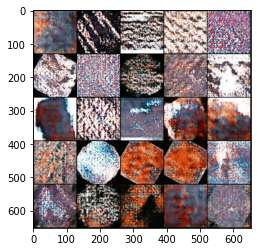

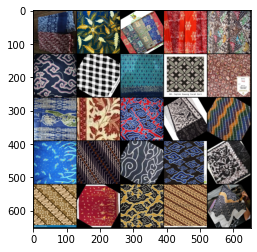

Epoch: 36: Step 2905: Generator loss 32.16362511771066, Critic loss -9.696499309539798


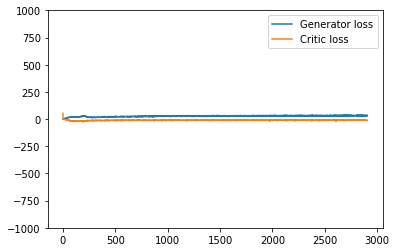

saving checkpoint 2906 35
saving checkpoint 2907 35
saving checkpoint 2908 35
saving checkpoint 2909 35
saving checkpoint 2910 35
saving checkpoint 2911 35
saving checkpoint 2912 35
saving checkpoint 2913 35
saving checkpoint 2914 35
saving checkpoint 2915 35
saving checkpoint 2916 35
saving checkpoint 2917 35
saving checkpoint 2918 35
saving checkpoint 2919 35
saving checkpoint 2920 35
saving checkpoint 2921 35
saving checkpoint 2922 35


  0%|          | 0/79 [00:00<?, ?it/s]

saving checkpoint 2923 35
saving checkpoint 2924 35
saving checkpoint 2925 35
saving checkpoint 2926 35
saving checkpoint 2927 35
saving checkpoint 2928 35
saving checkpoint 2929 35
saving checkpoint 2930 35
saving checkpoint 2931 35
saving checkpoint 2932 35
saving checkpoint 2933 35
saving checkpoint 2934 35
saving checkpoint 2935 35
saving checkpoint 2936 35
saving checkpoint 2937 35
saving checkpoint 2938 35


KeyboardInterrupt: ignored

In [ ]:
# training loop
for epoch in range(n_epochs):
  for real, _ in tqdm(dataloader):
    cur_bs = len(real) #128
    real = real.to(device)
    # critic
    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()
      noise = gen_noise(cur_bs, z_dim)
      fake = gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)
      # calculate gradient penalty
      alpha = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True) # 128x1x1x1
      gp = get_gp(real, fake.detach(), crit, alpha)
      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp
      mean_crit_loss += crit_loss.item() / crit_cycles
      crit_loss.backward(retain_graph=True)
      crit_opt.step()
    crit_losses += [mean_crit_loss]
    # generator
    gen_opt.zero_grad()
    noise = gen_noise(cur_bs, z_dim)
    fake = gen(noise)
    crit_fake_pred = crit(fake)
    gen_loss = -crit_fake_pred.mean()
    gen_loss.backward()
    gen_opt.step()
    gen_losses += [gen_loss.item()]

    # stats
    if(wandbact==1):
      wandb.log({'Epoch': epoch, 'Step': cur_step, 'Critic loss': mean_crit_loss, 'Gen loss': gen_loss})
    
    if cur_step % save_step and cur_step > 0:
      print("saving checkpoint", cur_step, save_step)
      save_checkpoint("latest")
      
    if(cur_step % show_step == 0 and cur_step > 0):
      show(fake, wandbactive=1, name='Fake')
      show(real, wandbactive=1, name='Real')

      gen_mean = sum(gen_losses[-show_step:]) / show_step
      crit_mean = sum(crit_losses[-show_step:]) / show_step
      print(f"Epoch: {epoch}: Step {cur_step}: Generator loss {gen_mean}, Critic loss {crit_mean}")

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(gen_losses),
          label = "Generator loss"
      )
      plt.plot(
          range(len(crit_losses)),
          torch.Tensor(crit_losses),
          label = "Critic loss"
      )

      plt.ylim(-1000, 1000)
      plt.legend()
      plt.show()
    
    cur_step += 1


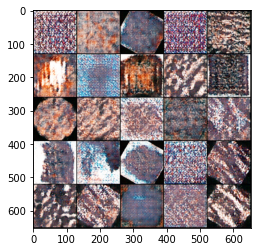

In [ ]:
# generate
noise = gen_noise(batch_size, z_dim)
fake = gen(noise)
show(fake)

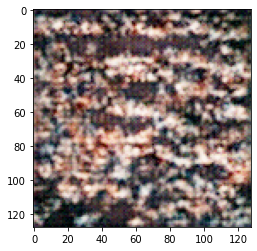

In [ ]:
plt.imshow(fake[4].detach().cpu().permute(1,2,0).squeeze().clip(0,1))

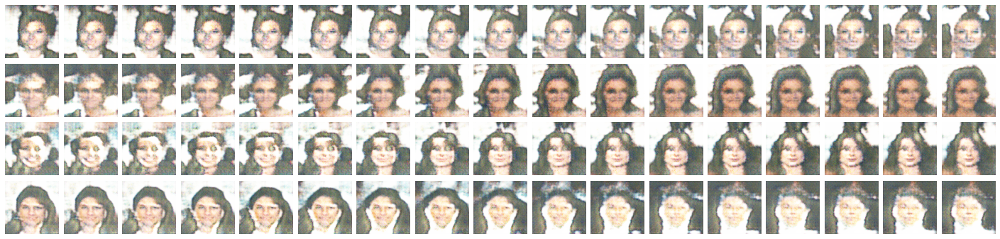

In [ ]:
# morphing, interpolating between point in latent space
from mpl_toolkits.axes_grid1 import ImageGrid

# MORPHING, interpolation between points in latent space
gen_set=[]
z_shape=[1,200,1,1]
rows=4
steps=17

for i in range(rows):
  z1,z2 = torch.randn(z_shape), torch.randn(z_shape)
  for alpha in np.linspace(0,1,steps):
    z=alpha*z1 + (1-alpha)*z2
    res=gen(z.cuda())[0]
    gen_set.append(res)

fig = plt.figure(figsize=(25,11))
grid=ImageGrid(fig, 111, nrows_ncols=(rows,steps), axes_pad=0.1)

for ax , img in zip (grid, gen_set):
  ax.axis('off')
  res=img.cpu().detach().permute(1,2,0)
  res=res-res.min()
  res=res/(res.max()-res.min())
  ax.imshow(res.clip(0,1.0))

plt.show()